In [1]:
import numpy as np
from PIL import Image

from repath.utils.paths import project_root

In [2]:
experiment_name6 = "bloodmucus_nn"
experiment_root6 = project_root() / "experiments" / experiment_name6

In [3]:
rwst = 270
rwed = 343
clst = 50
cled = 150

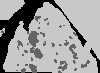

In [4]:
annots = Image.open(experiment_root6 / 'annot_out' / "0_cd.png")
annots = np.asarray(annots)
annots = annots[rwst:rwed, clst:cled]
Image.fromarray(annots)

In [5]:
feat_lev = 4
out_lev = 7
lev_diff = int(2**out_lev / 2**feat_lev)
lev_diff

8

In [6]:
import repath.data.datasets.bloodmucus as bloodm

dset = bloodm.validation()
slide_path, annot_path, _, _ = dset[0]
with dset.slide_cls(dset.root / slide_path) as slide:
    thumb = slide.get_thumbnail(feat_lev)

In [7]:
from repath.preprocess.tissue_detection import TissueDetectorGreyScale, SizedClosingTransform, FillHolesTransform
from repath.preprocess.tissue_detection.blood_mucus_rework import set_background_to_white

# define tissue detector
morphology_transform1 = SizedClosingTransform(level_in=feat_lev)
morphology_transform2 = FillHolesTransform(level_in=feat_lev)
morphology_transforms = [morphology_transform1, morphology_transform2]
tissue_detector = TissueDetectorGreyScale(grey_level=0.85, morph_transform = morphology_transforms)

white_thumbs = set_background_to_white([thumb], tissue_detector)
white_thumb = white_thumbs[0]

In [8]:
from repath.postprocess.blood_mucus_results import get_annot_areas

annot_areaz = get_annot_areas(dset, feat_lev)

pixvals = np.where(annot_areaz[0] > 0)
minrw = min(pixvals[0])
maxrw = max(pixvals[0])+1
mincl = min(pixvals[1])
maxcl = max(pixvals[1])+1

cd_thumb = white_thumb[minrw:maxrw, mincl:maxcl, :]

(2732, 2945, 3)


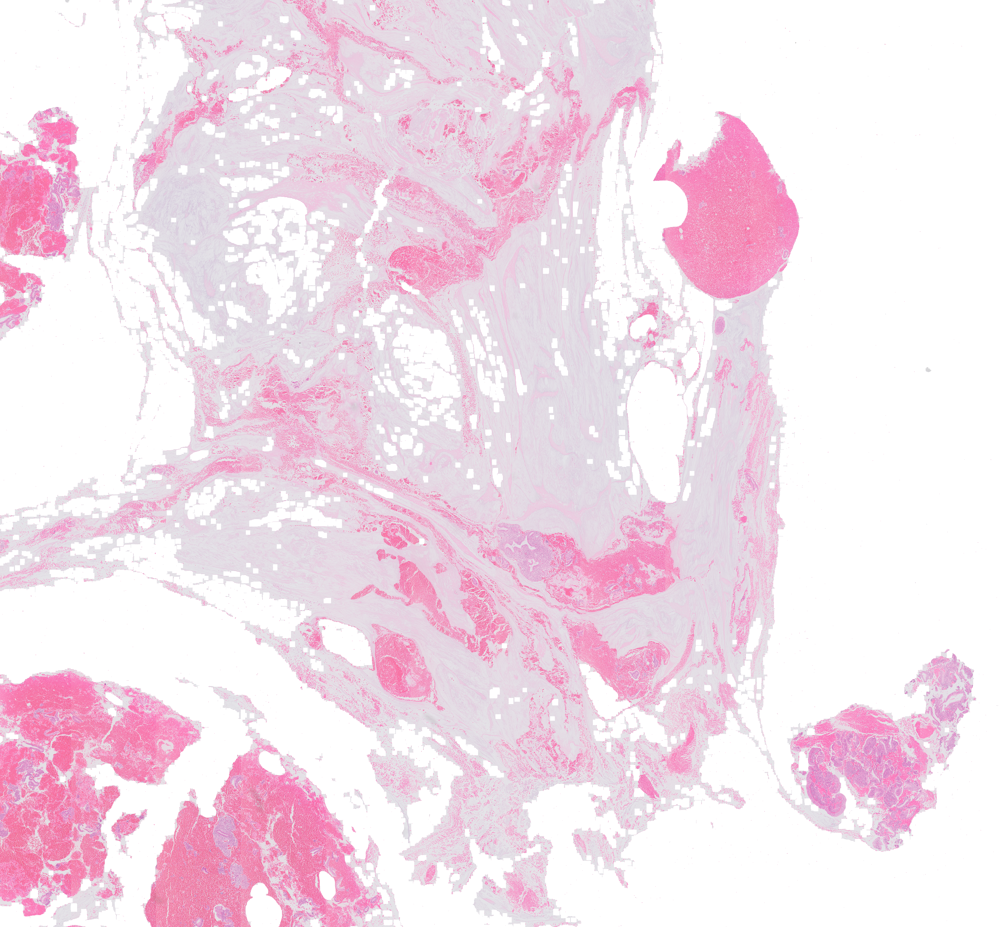

In [9]:
print(cd_thumb.shape)
Image.fromarray(cd_thumb)

In [10]:
tst_thumb = cd_thumb[rwst*lev_diff:rwed*lev_diff, clst*lev_diff:cled*lev_diff]
print(tst_thumb.shape)

(572, 800, 3)


In [11]:
ah = annots.shape[0]
aw = annots.shape[1]
newaw = aw * lev_diff
newah = ah * lev_diff
print(newah, newaw)
annots_featlev = Image.fromarray(annots)
annots_featlev = annots_featlev.resize((newaw, newah))

584 800


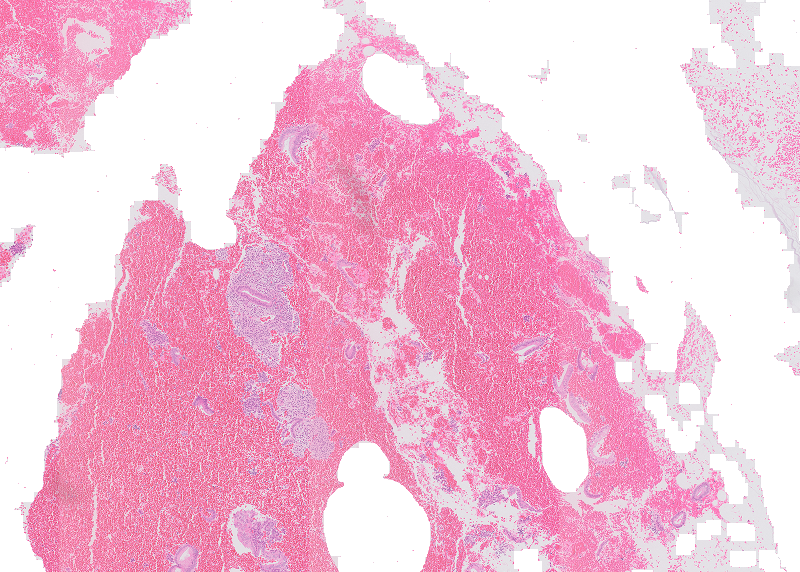

In [12]:
Image.fromarray(tst_thumb)

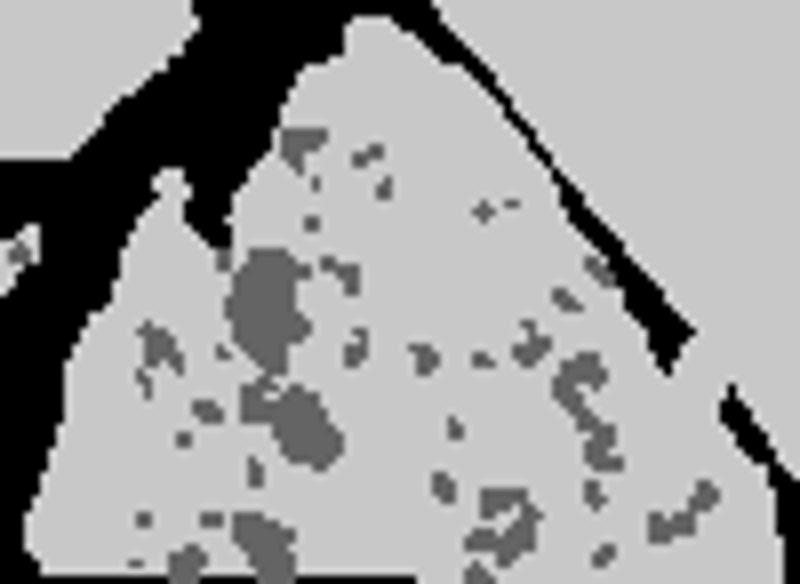

In [13]:
annots_featlev

In [14]:
sigma_max = 16
sigma_min = 1
num_sigma = int(np.log2(sigma_max) - np.log2(sigma_min) + 1)
sigmas = np.logspace(
    np.log2(sigma_min),
    np.log2(sigma_max),
    num=num_sigma,
    base=2,
    endpoint=True,
)
sigmas = np.hstack((0, sigmas))
sigmas

array([ 0.,  1.,  2.,  4.,  8., 16.])

In [15]:
from skimage import filters

rrr = tst_thumb[:, :, 0]
ggg = tst_thumb[:, :, 1]
bbb = tst_thumb[:, :, 2]

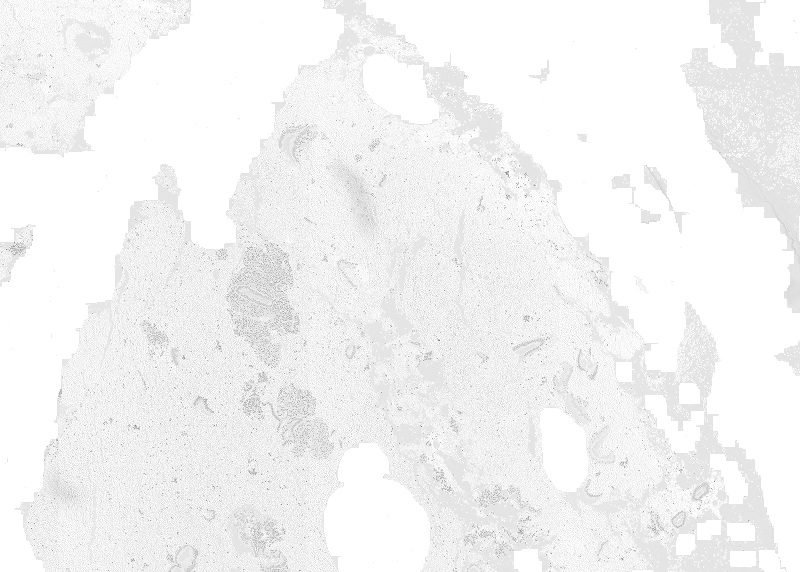

In [16]:
Image.fromarray(rrr)

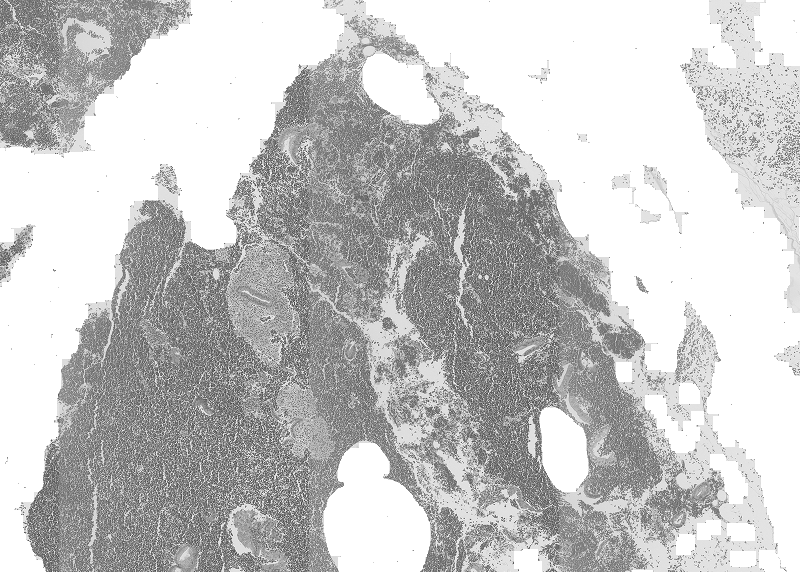

In [17]:
Image.fromarray(ggg)

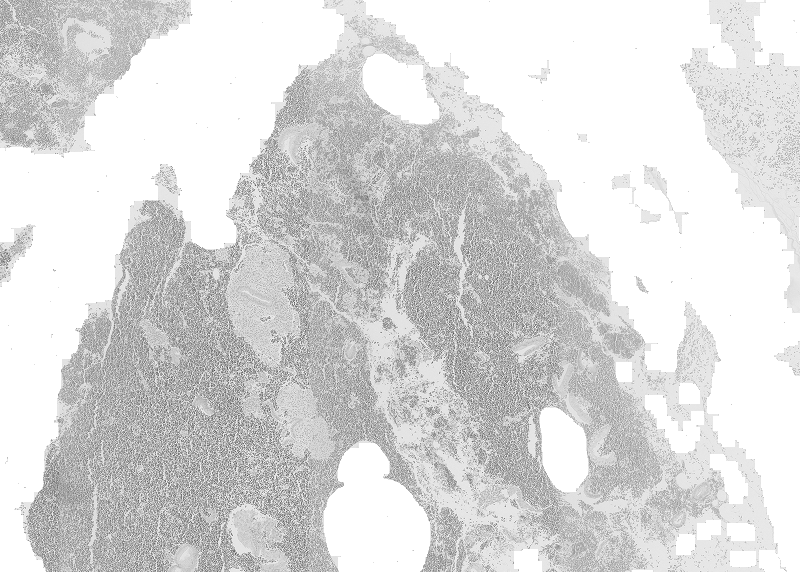

In [18]:
Image.fromarray(bbb)

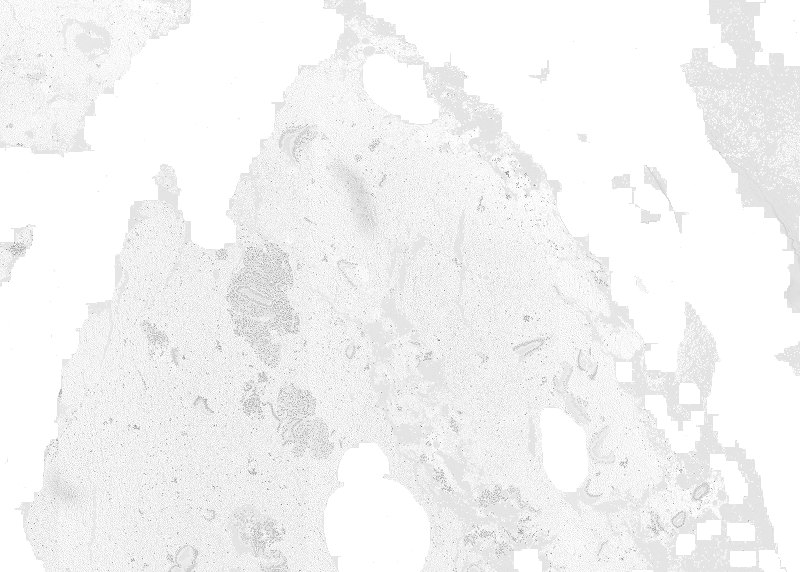

In [19]:
gf_rrr0 = filters.gaussian(rrr, sigmas[0])
Image.fromarray(np.array(gf_rrr0*255, dtype=np.uint8))

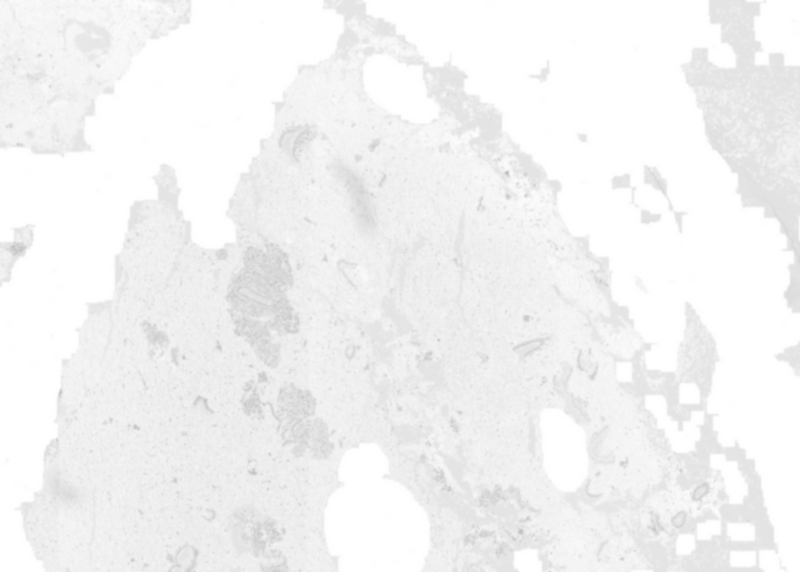

In [20]:
gf_rrr1 = filters.gaussian(rrr, sigmas[1])
Image.fromarray(np.array(gf_rrr1*255, dtype=np.uint8))

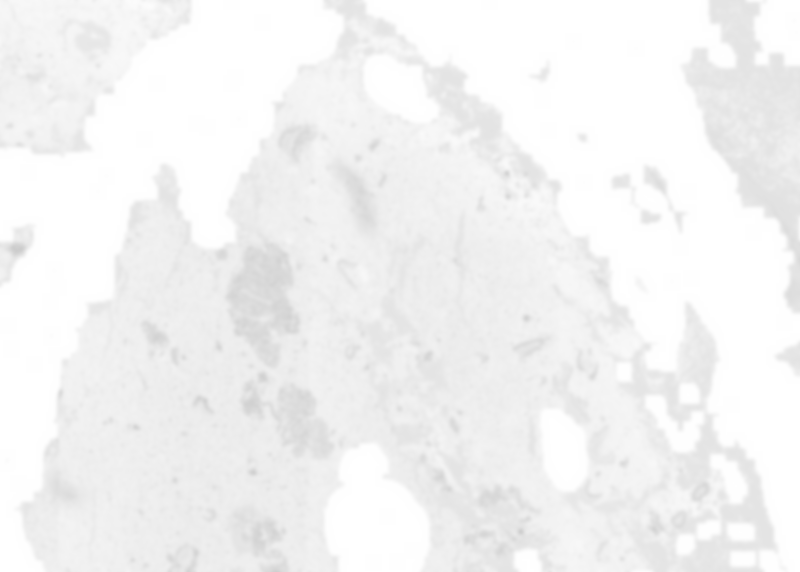

In [21]:
gf_rrr2 = filters.gaussian(rrr, sigmas[2])
Image.fromarray(np.array(gf_rrr2*255, dtype=np.uint8))

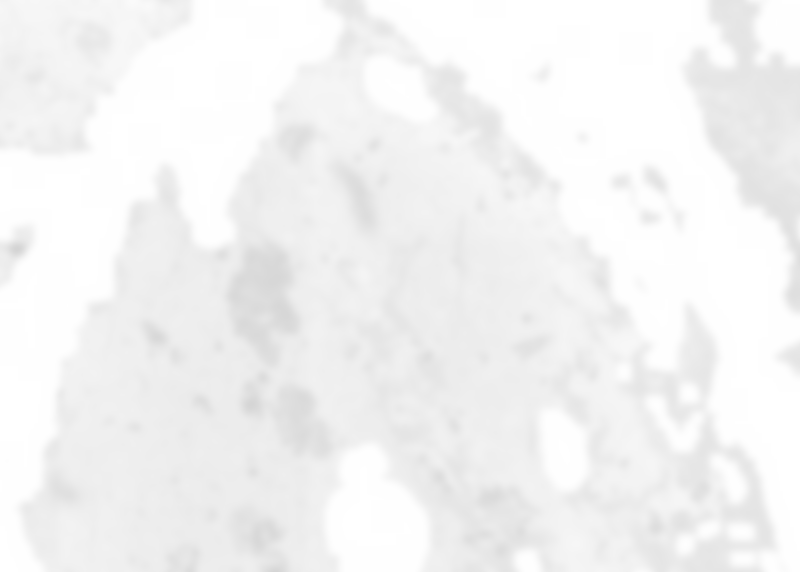

In [22]:
gf_rrr3 = filters.gaussian(rrr, sigmas[3])
Image.fromarray(np.array(gf_rrr3*255, dtype=np.uint8))

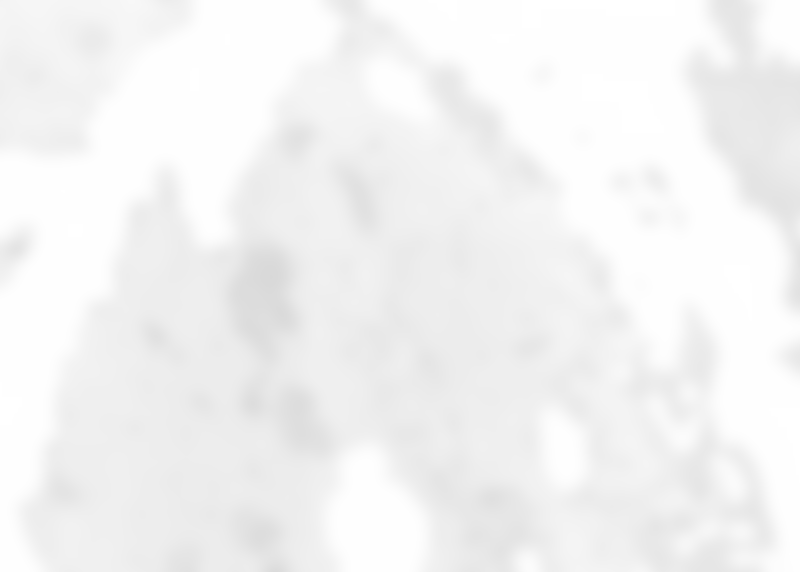

In [23]:
gf_rrr4 = filters.gaussian(rrr, sigmas[4])
Image.fromarray(np.array(gf_rrr4*255, dtype=np.uint8))

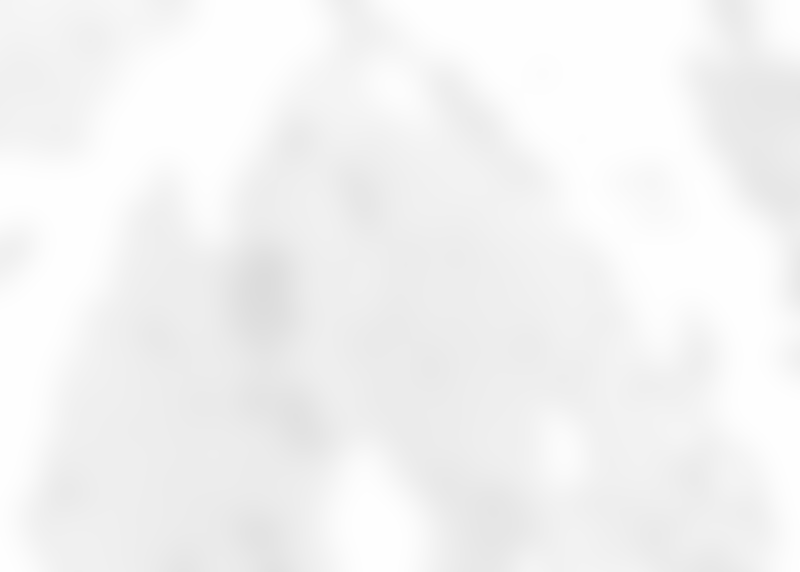

In [24]:
gf_rrr5 = filters.gaussian(rrr, sigmas[5])
Image.fromarray(np.array(gf_rrr5*255, dtype=np.uint8))

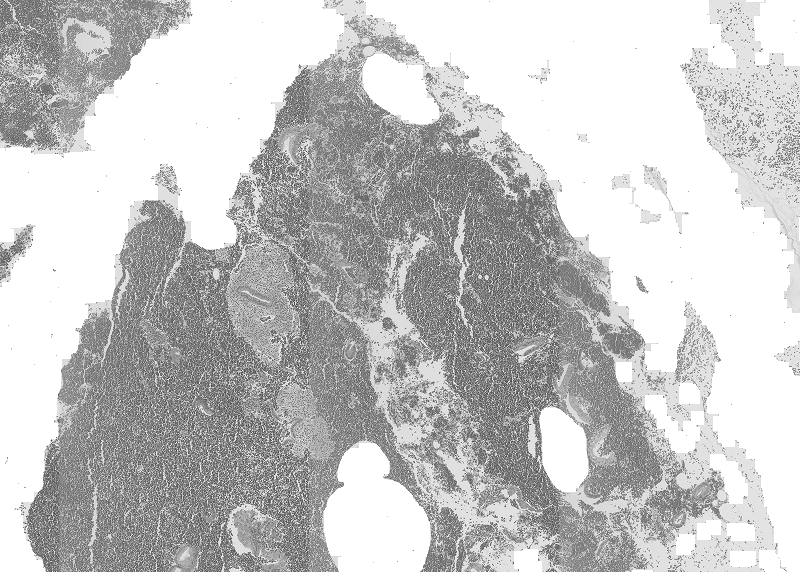

In [25]:
gf_ggg0 = filters.gaussian(ggg, sigmas[0])
Image.fromarray(np.array(gf_ggg0*255, dtype=np.uint8))

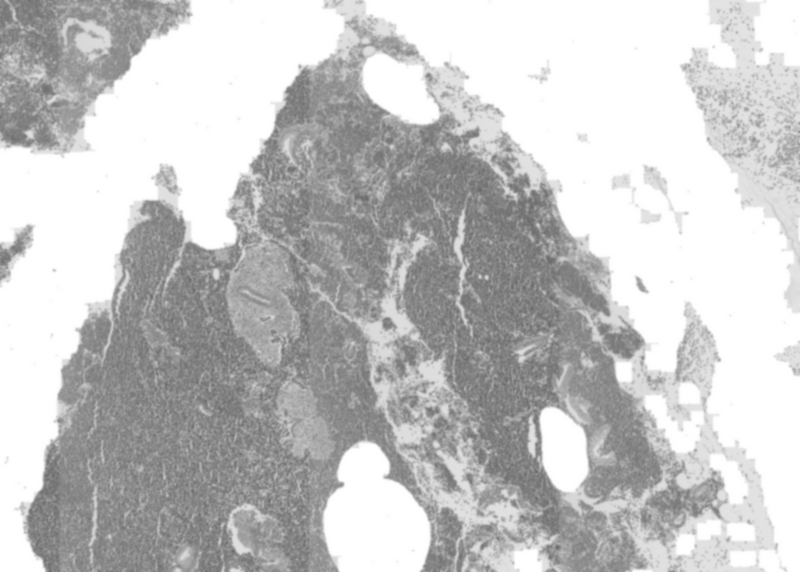

In [26]:
gf_ggg1 = filters.gaussian(ggg, sigmas[1])
Image.fromarray(np.array(gf_ggg1*255, dtype=np.uint8))

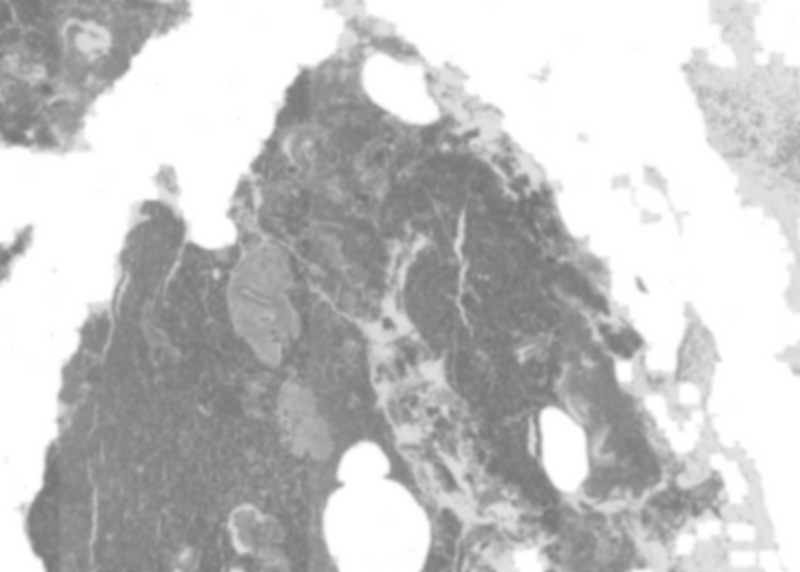

In [27]:
gf_ggg2 = filters.gaussian(ggg, sigmas[2])
Image.fromarray(np.array(gf_ggg2*255, dtype=np.uint8))

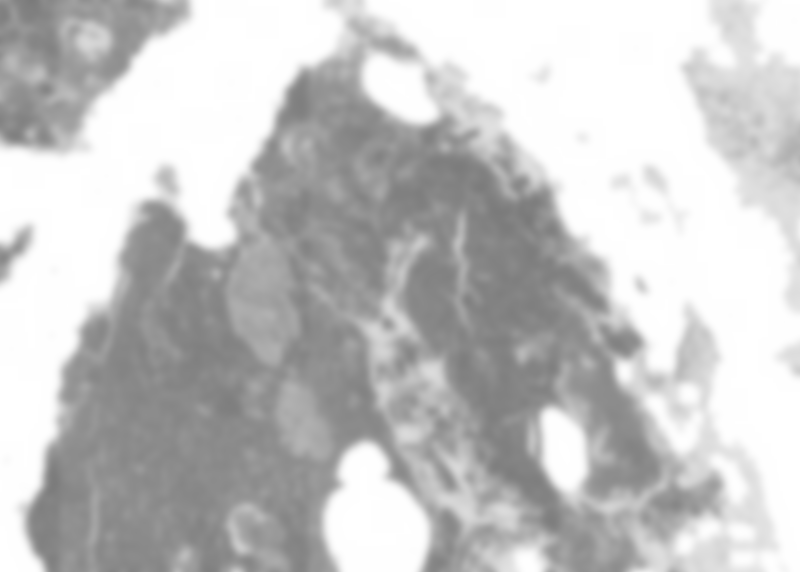

In [28]:
gf_ggg3 = filters.gaussian(ggg, sigmas[3])
Image.fromarray(np.array(gf_ggg3*255, dtype=np.uint8))

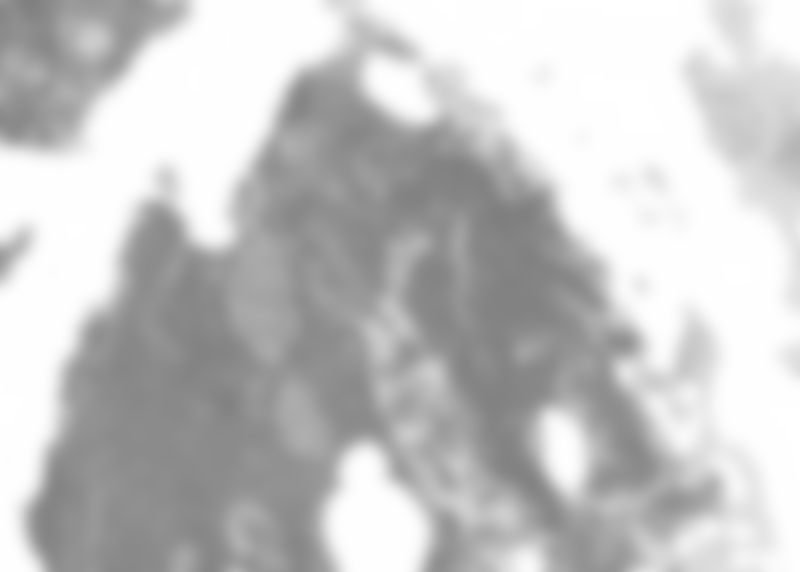

In [29]:
gf_ggg4 = filters.gaussian(ggg, sigmas[4])
Image.fromarray(np.array(gf_ggg4*255, dtype=np.uint8))

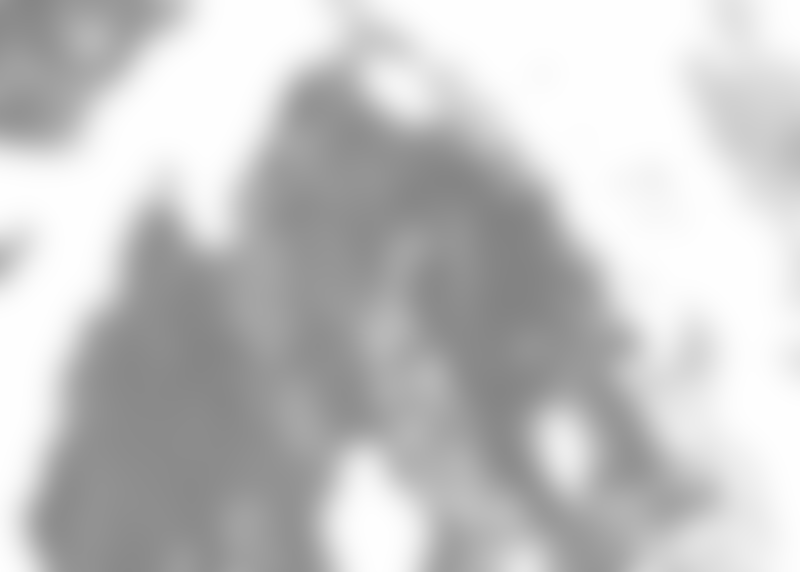

In [30]:
gf_ggg5 = filters.gaussian(ggg, sigmas[5])
Image.fromarray(np.array(gf_ggg5*255, dtype=np.uint8))

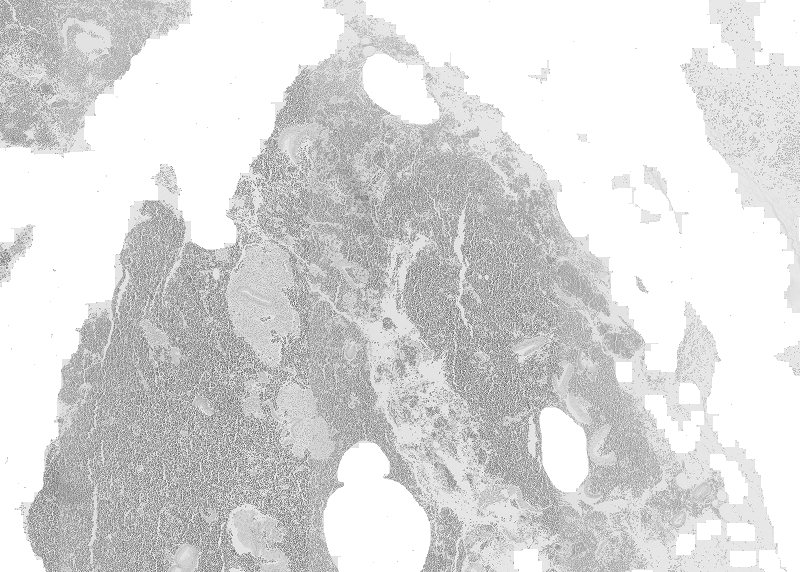

In [31]:
gf_bbb0 = filters.gaussian(bbb, sigmas[0])
Image.fromarray(np.array(gf_bbb0*255, dtype=np.uint8))

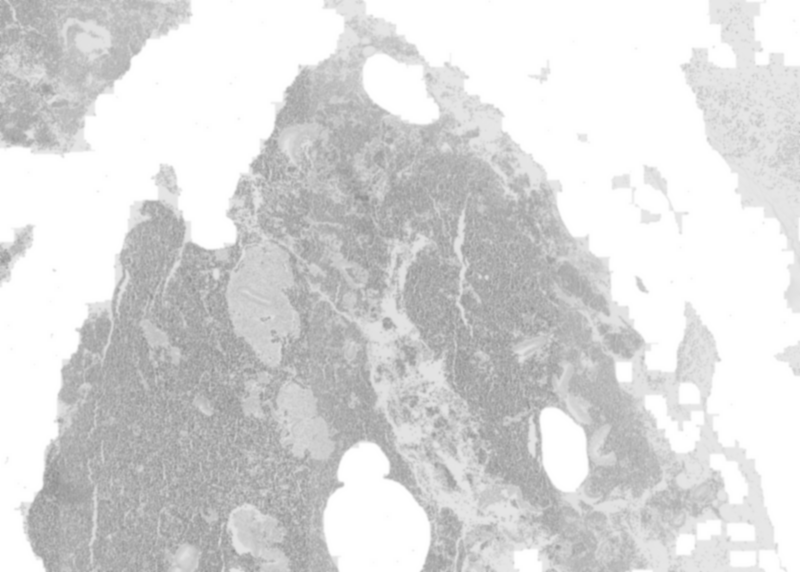

In [32]:
gf_bbb1 = filters.gaussian(bbb, sigmas[1])
Image.fromarray(np.array(gf_bbb1*255, dtype=np.uint8))

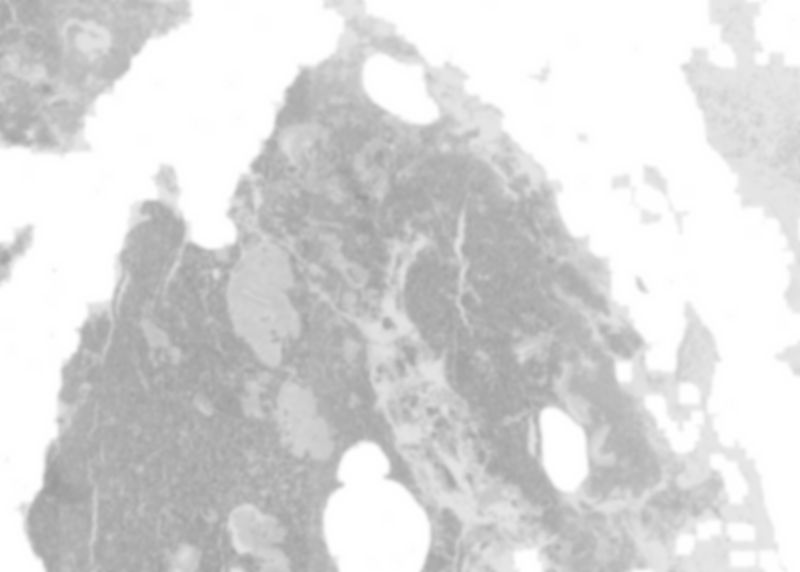

In [33]:
gf_bbb2 = filters.gaussian(bbb, sigmas[2])
Image.fromarray(np.array(gf_bbb2*255, dtype=np.uint8))

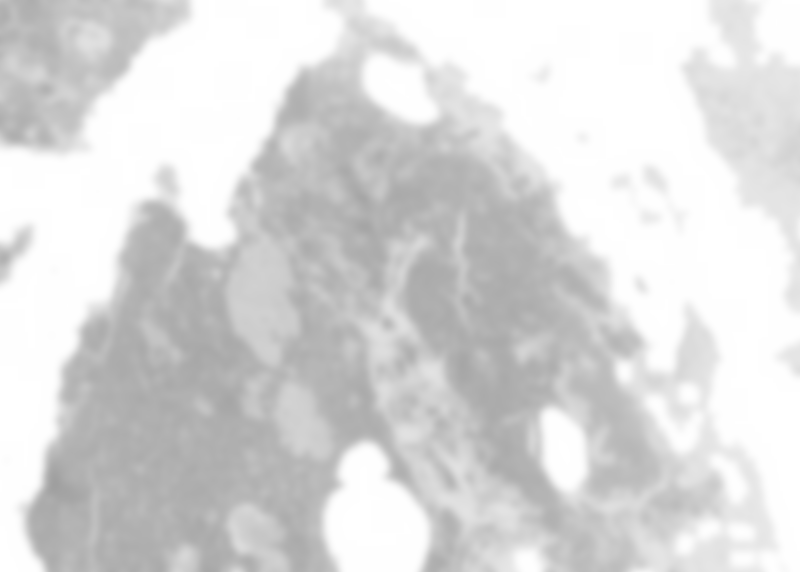

In [34]:
gf_bbb3 = filters.gaussian(bbb, sigmas[3])
Image.fromarray(np.array(gf_bbb3*255, dtype=np.uint8))

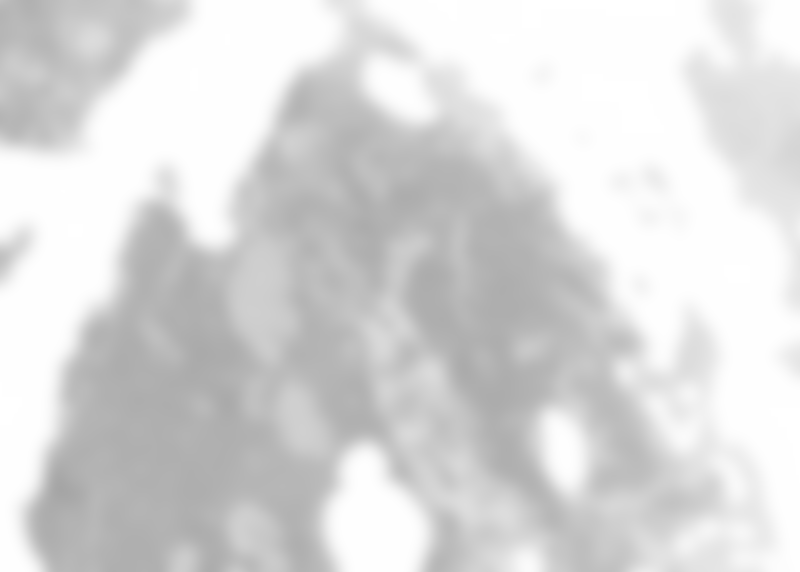

In [35]:
gf_bbb4 = filters.gaussian(bbb, sigmas[4])
Image.fromarray(np.array(gf_bbb4*255, dtype=np.uint8))

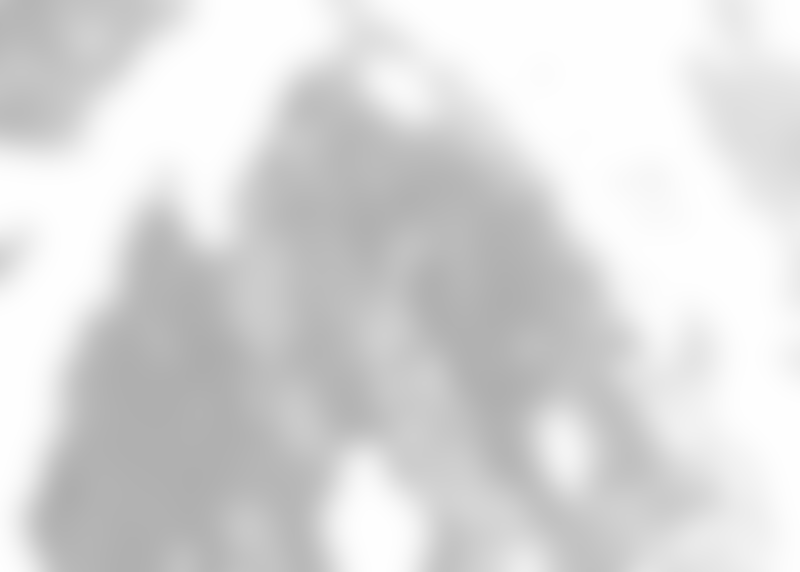

In [36]:
gf_bbb5 = filters.gaussian(bbb, sigmas[5])
Image.fromarray(np.array(gf_bbb5*255, dtype=np.uint8))

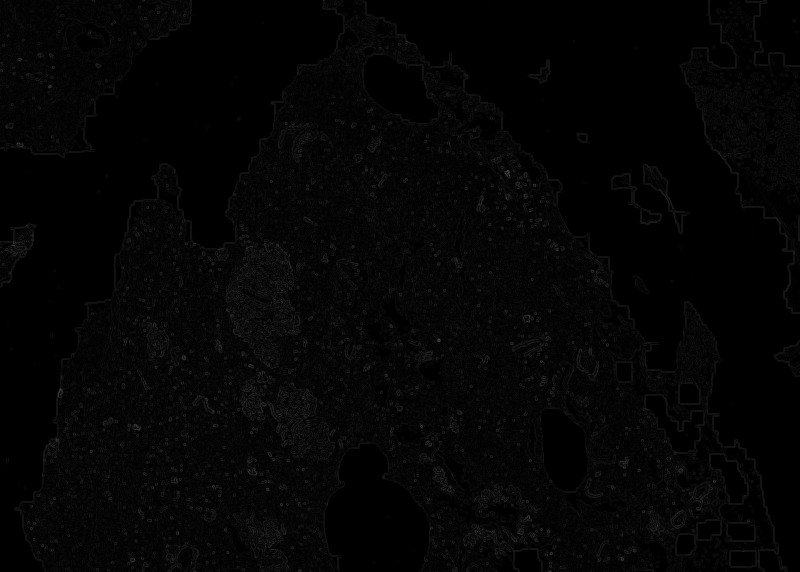

In [99]:
Image.fromarray(np.array(filters.sobel(gf_rrr0)*255, dtype=np.uint8))

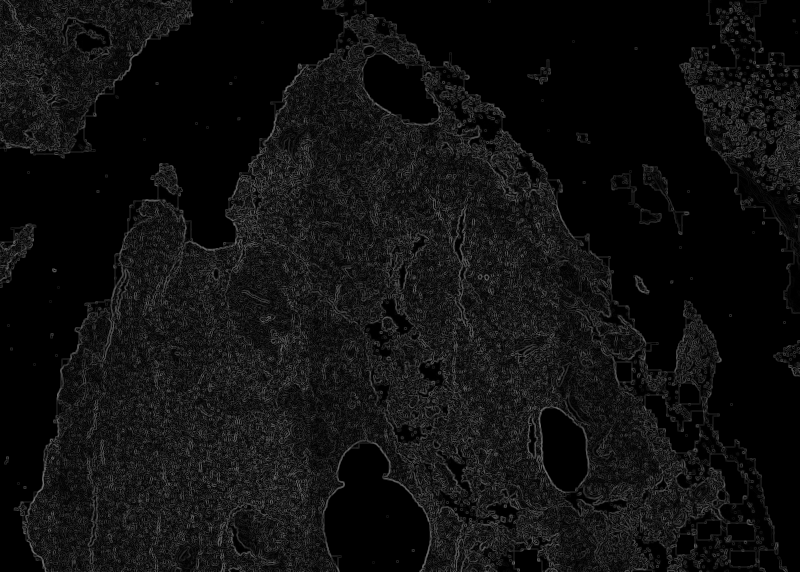

In [38]:
Image.fromarray(np.array(filters.sobel(gf_ggg0)*255, dtype=np.uint8))

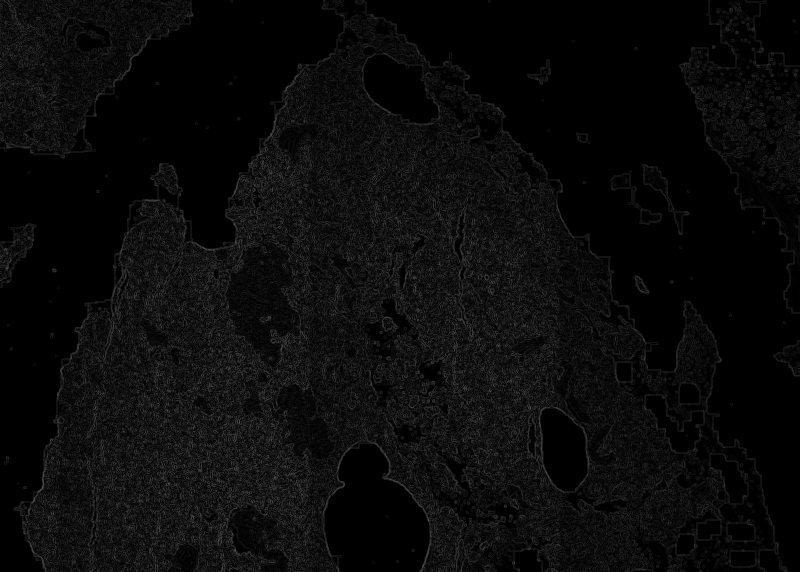

In [39]:
Image.fromarray(np.array(filters.sobel(gf_bbb0)*255, dtype=np.uint8))

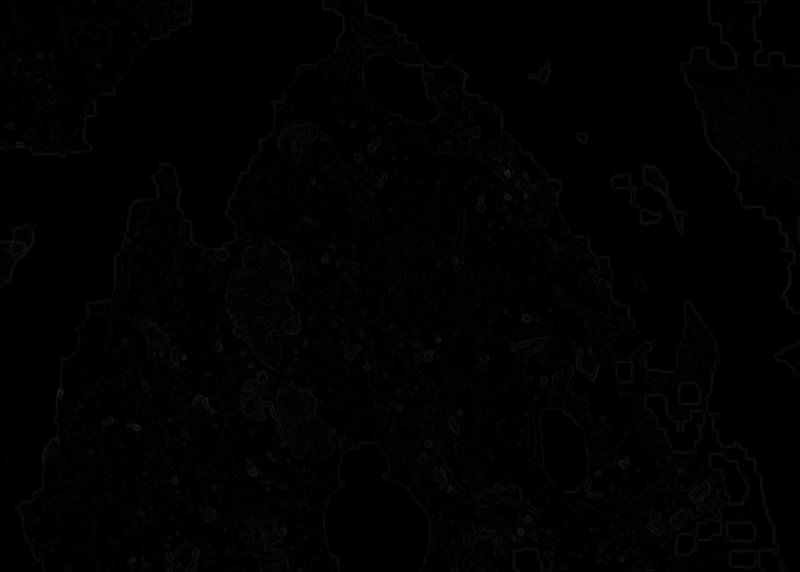

In [40]:
Image.fromarray(np.array(filters.sobel(gf_rrr1)*255, dtype=np.uint8))

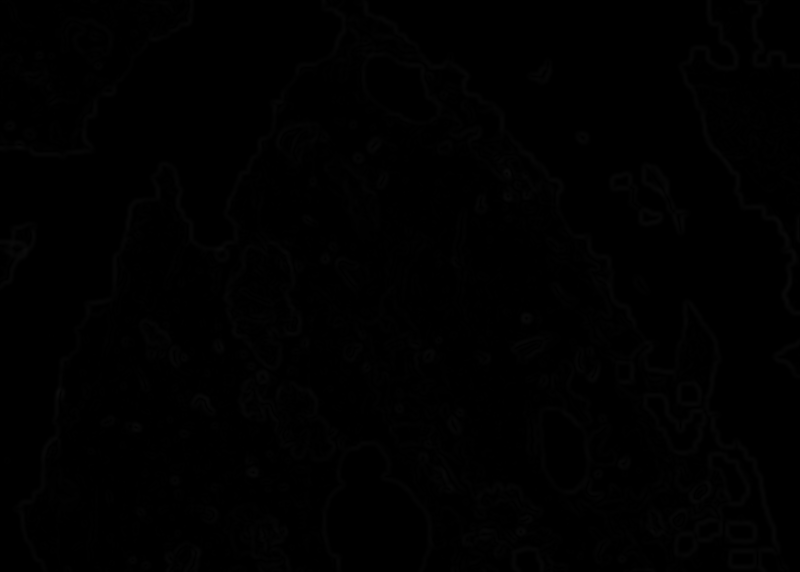

In [41]:
Image.fromarray(np.array(filters.sobel(gf_rrr2)*255, dtype=np.uint8))

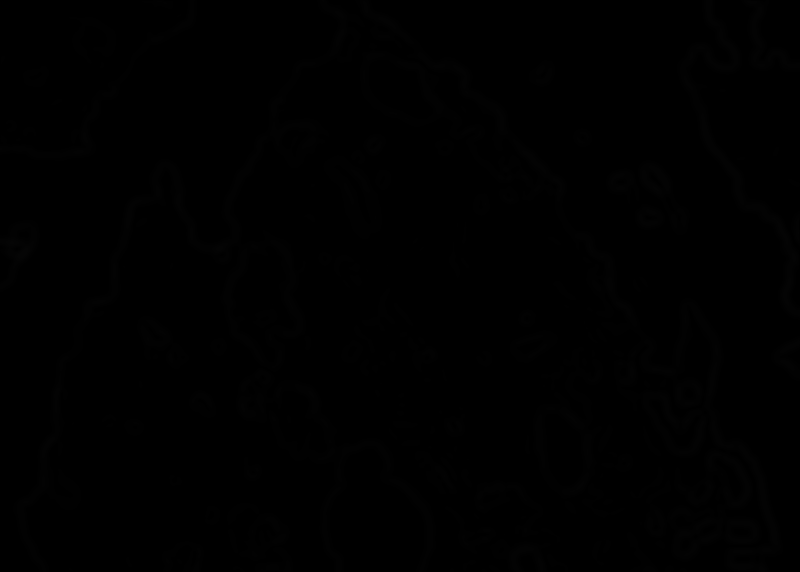

In [42]:
Image.fromarray(np.array(filters.sobel(gf_rrr3)*255, dtype=np.uint8))

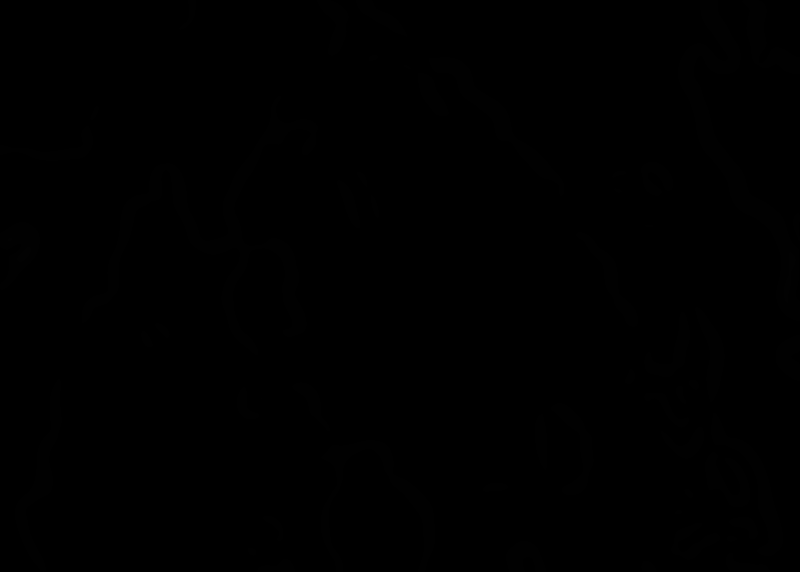

In [43]:
Image.fromarray(np.array(filters.sobel(gf_rrr4)*255, dtype=np.uint8))

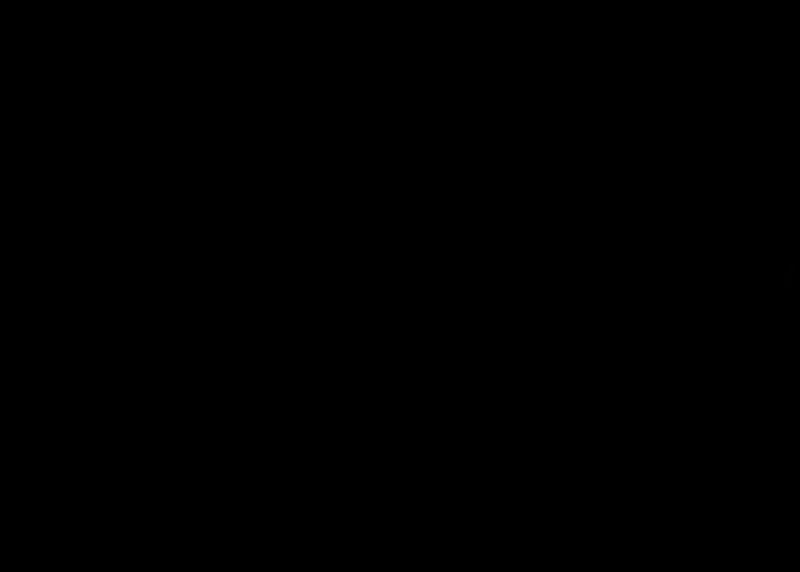

In [44]:
Image.fromarray(np.array(filters.sobel(gf_rrr5)*255, dtype=np.uint8))

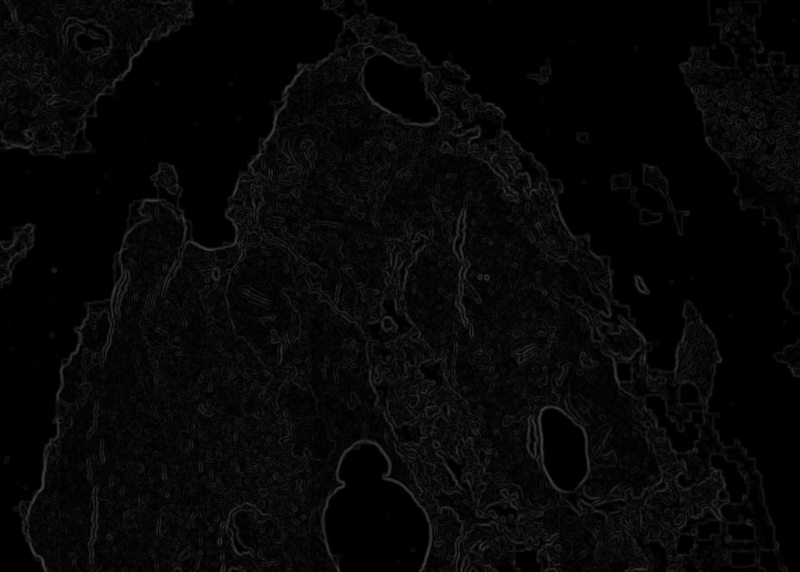

In [45]:
Image.fromarray(np.array(filters.sobel(gf_ggg1)*255, dtype=np.uint8))

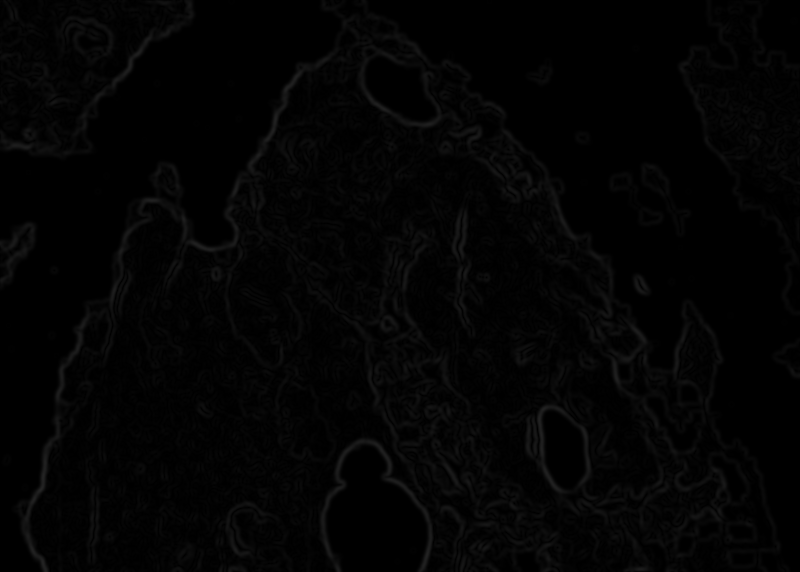

In [46]:
Image.fromarray(np.array(filters.sobel(gf_ggg2)*255, dtype=np.uint8))

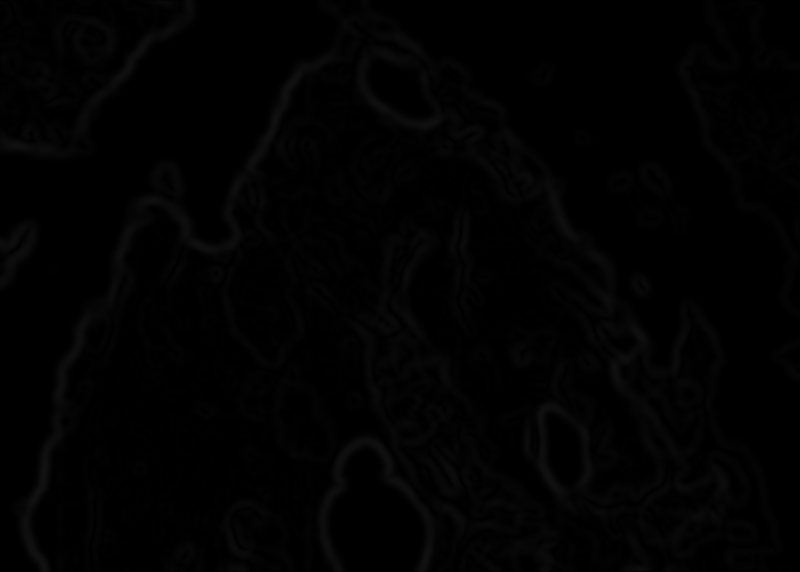

In [47]:
Image.fromarray(np.array(filters.sobel(gf_ggg3)*255, dtype=np.uint8))

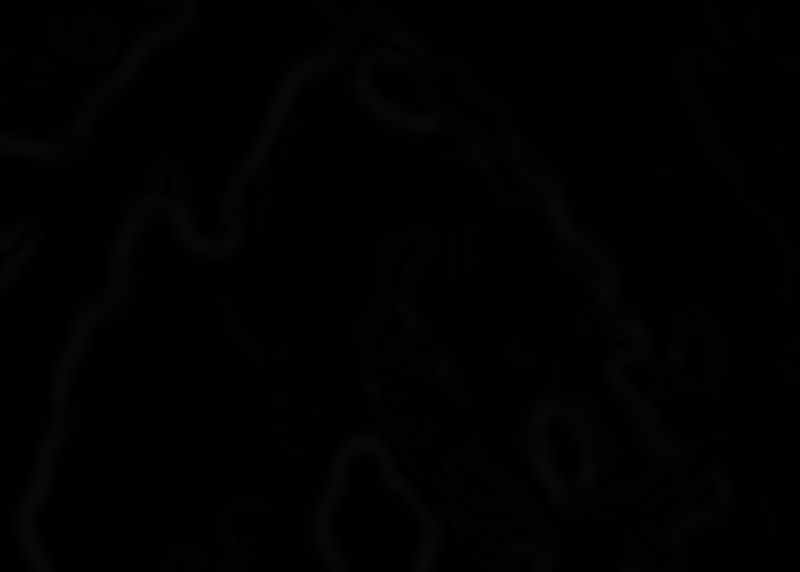

In [48]:
Image.fromarray(np.array(filters.sobel(gf_ggg4)*255, dtype=np.uint8))

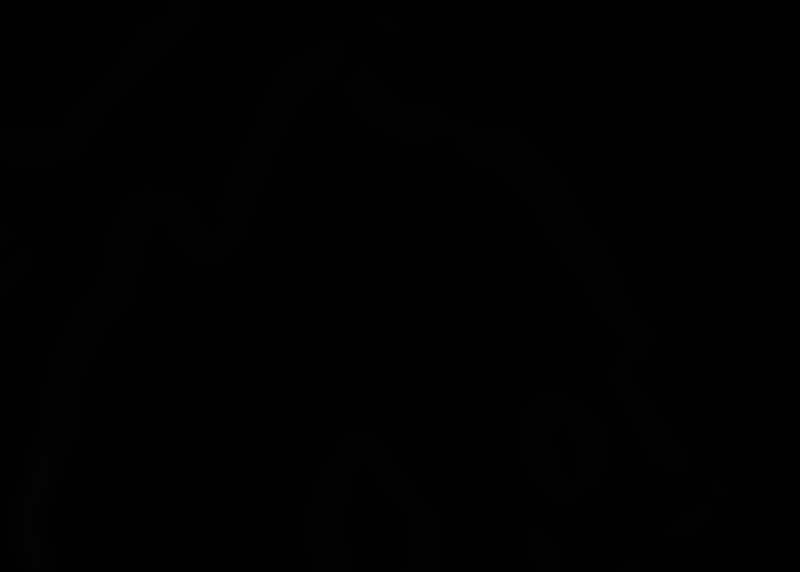

In [49]:
Image.fromarray(np.array(filters.sobel(gf_ggg5)*255, dtype=np.uint8))

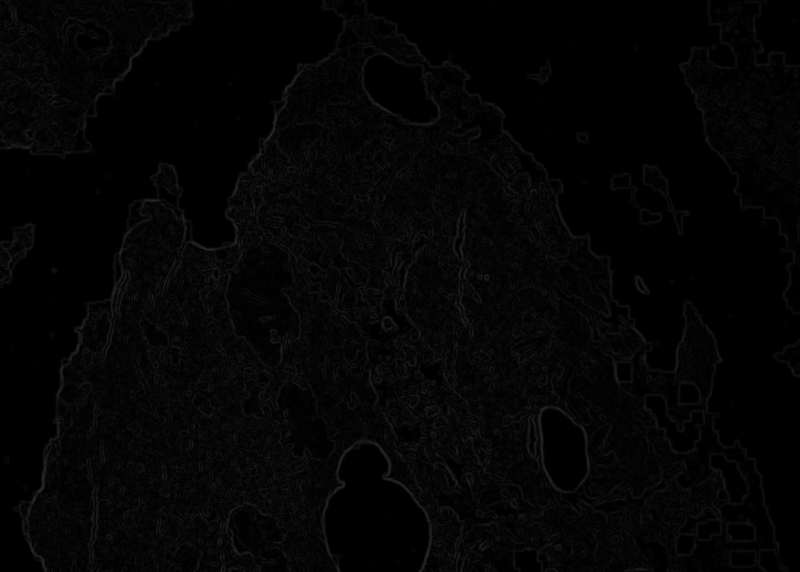

In [50]:
Image.fromarray(np.array(filters.sobel(gf_bbb1)*255, dtype=np.uint8))

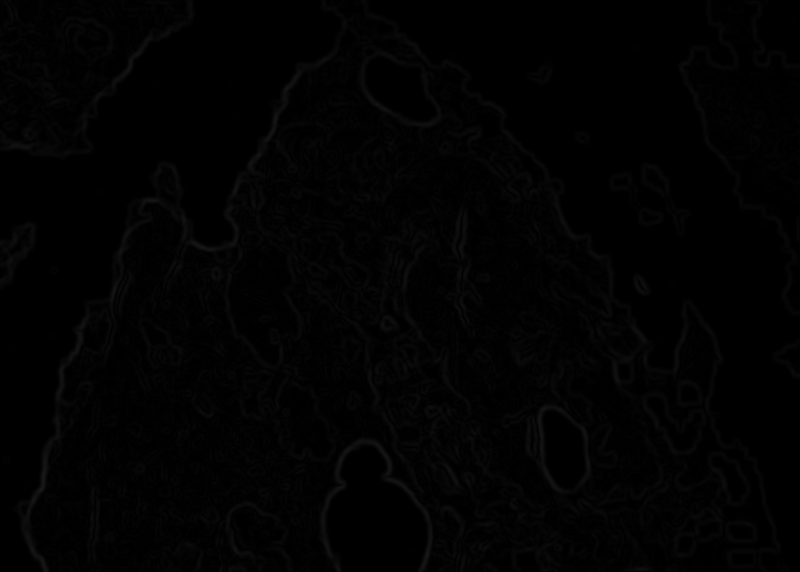

In [51]:
Image.fromarray(np.array(filters.sobel(gf_bbb2)*255, dtype=np.uint8))

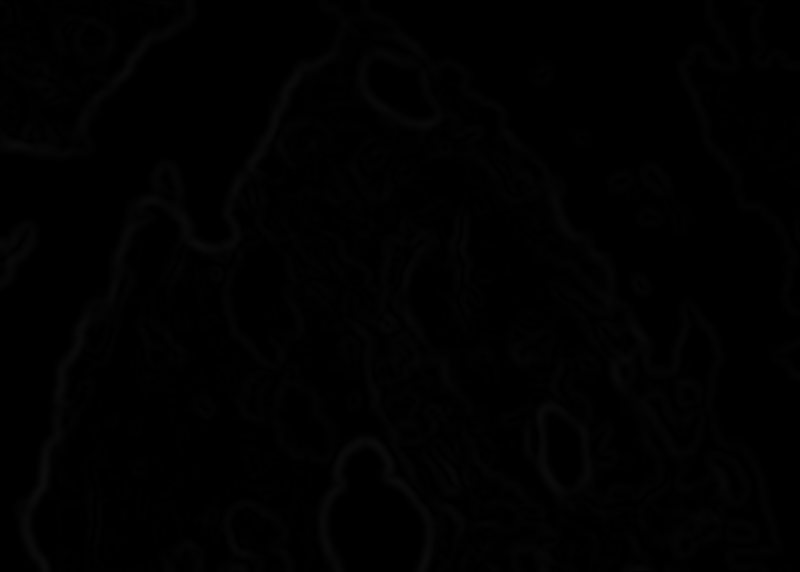

In [52]:
Image.fromarray(np.array(filters.sobel(gf_bbb3)*255, dtype=np.uint8))

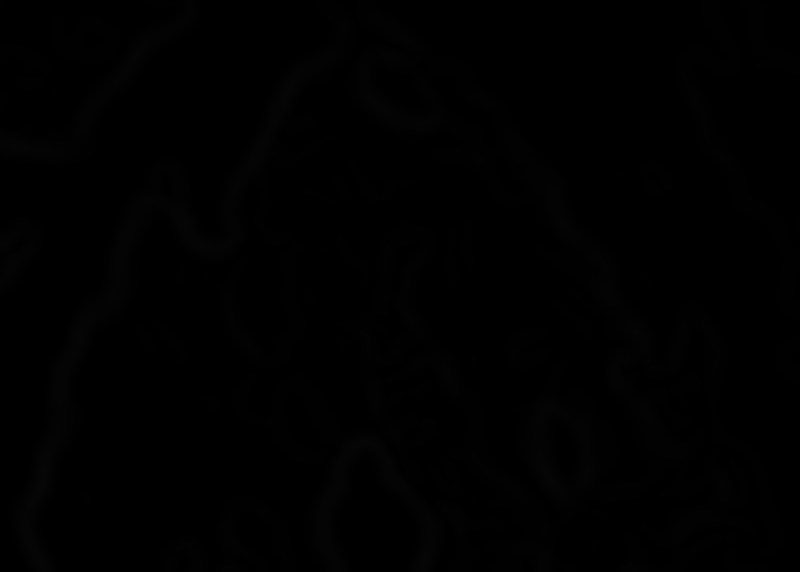

In [53]:
Image.fromarray(np.array(filters.sobel(gf_bbb4)*255, dtype=np.uint8))

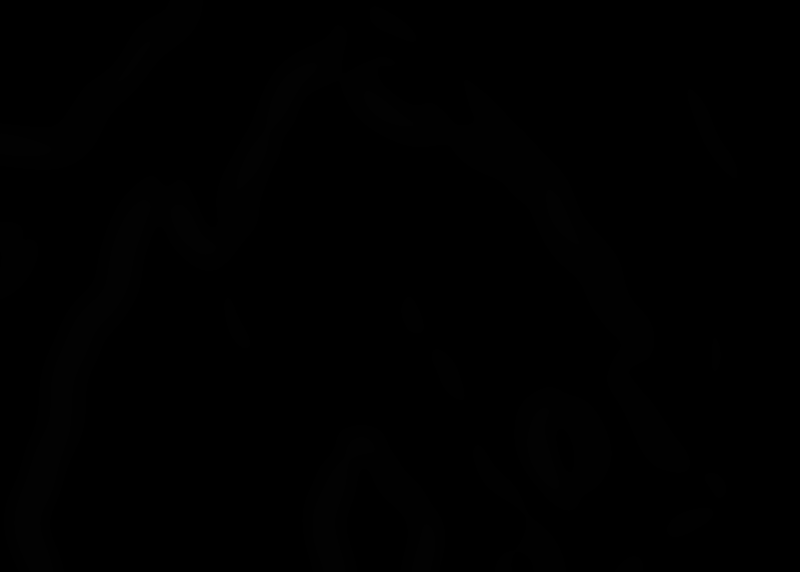

In [54]:
Image.fromarray(np.array(filters.sobel(gf_bbb5)*255, dtype=np.uint8))

In [55]:
from itertools import combinations_with_replacement
from skimage import feature

def texture_feature(image):
    H_elems = [
        np.gradient(np.gradient(image)[ax0], axis=ax1)
        for ax0, ax1 in combinations_with_replacement(range(image.ndim), 2)
    ]
    eigvals = feature.hessian_matrix_eigvals(H_elems)
    eigvals = np.dstack((np.expand_dims(eigvals[0, :, :], axis=-1), np.expand_dims(eigvals[1, :, :], axis=-1)))

    return eigvals

In [56]:
tf_rrr0 = texture_feature(gf_rrr0)
tf_ggg0 = texture_feature(gf_ggg0)
tf_bbb0 = texture_feature(gf_bbb0)

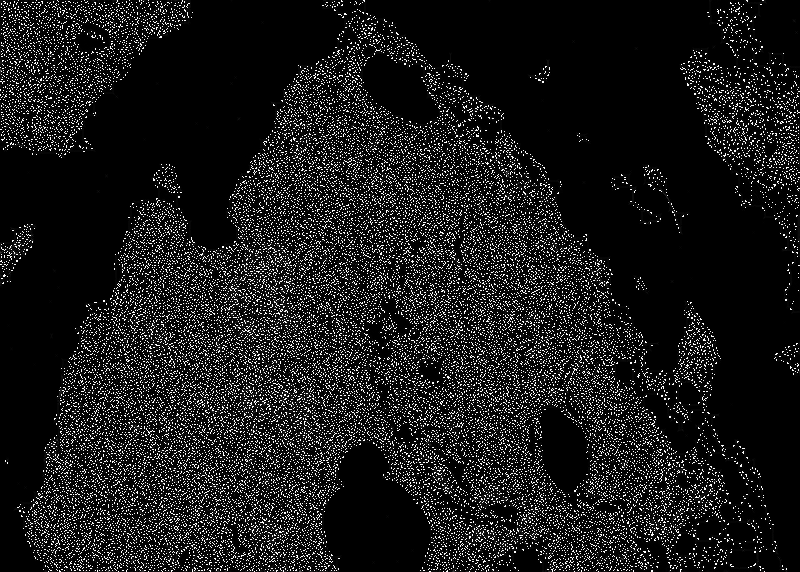

In [57]:
Image.fromarray(np.array(tf_rrr0[:, :, 0]*255, dtype=np.uint8))

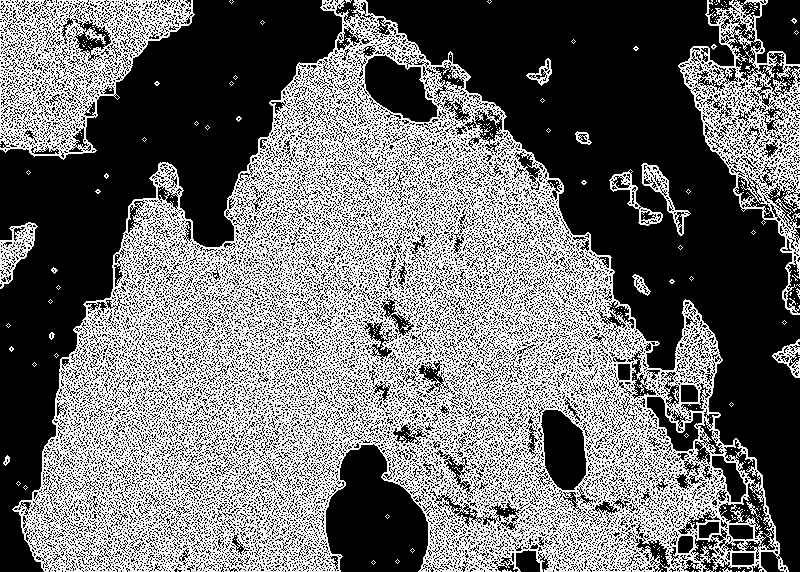

In [58]:
Image.fromarray(np.array(tf_rrr0[:, :, 1]*255, dtype=np.uint8))

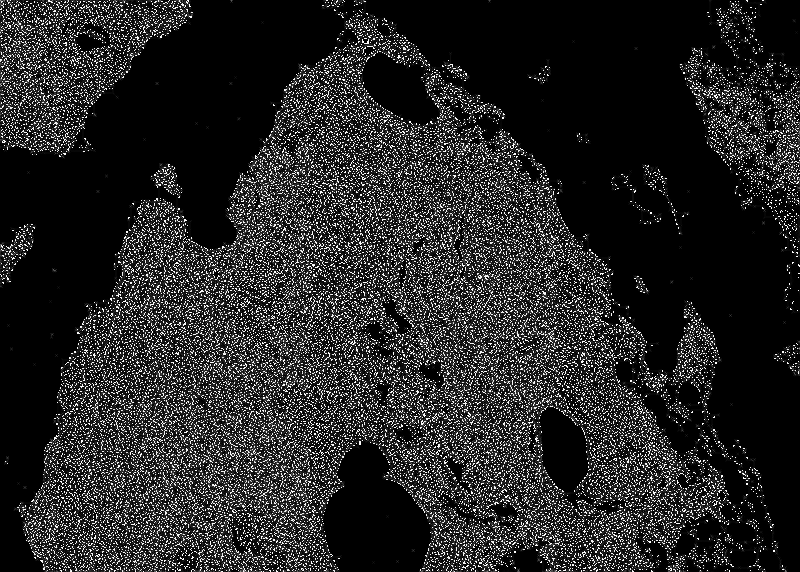

In [59]:
Image.fromarray(np.array(tf_ggg0[:, :, 0]*255, dtype=np.uint8))

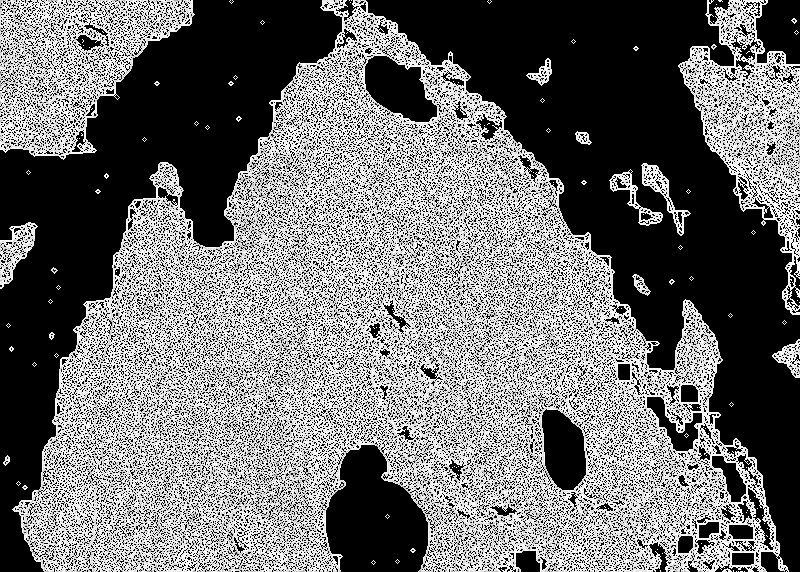

In [60]:
Image.fromarray(np.array(tf_ggg0[:, :, 1]*255, dtype=np.uint8))

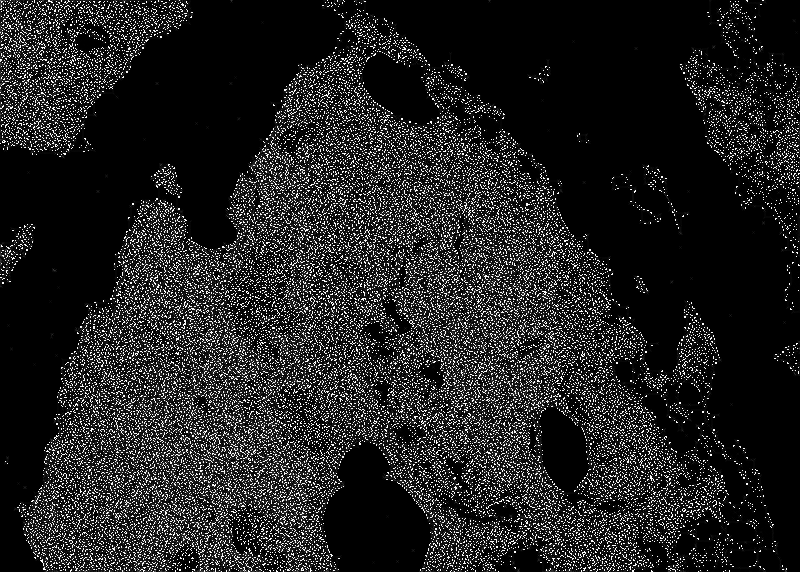

In [61]:
Image.fromarray(np.array(tf_bbb0[:, :, 0]*255, dtype=np.uint8))

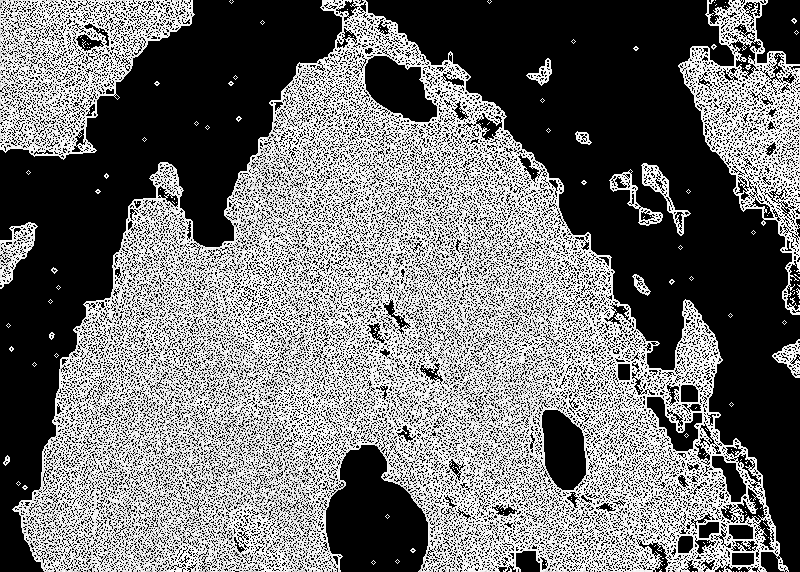

In [62]:
Image.fromarray(np.array(tf_bbb0[:, :, 1]*255, dtype=np.uint8))

In [63]:
tf_rrr1 = texture_feature(gf_rrr1)
tf_ggg1 = texture_feature(gf_ggg1)
tf_bbb1 = texture_feature(gf_bbb1)

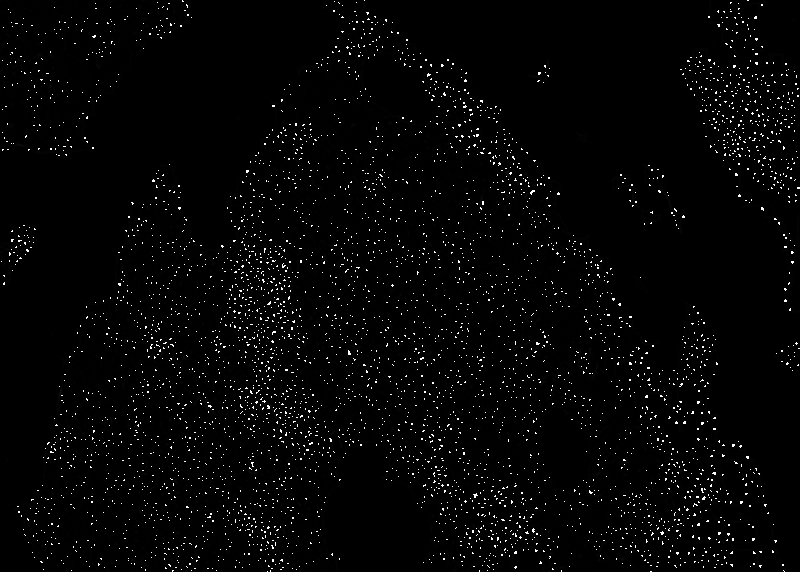

In [64]:
Image.fromarray(np.array(tf_rrr1[:, :, 0]*255, dtype=np.uint8))

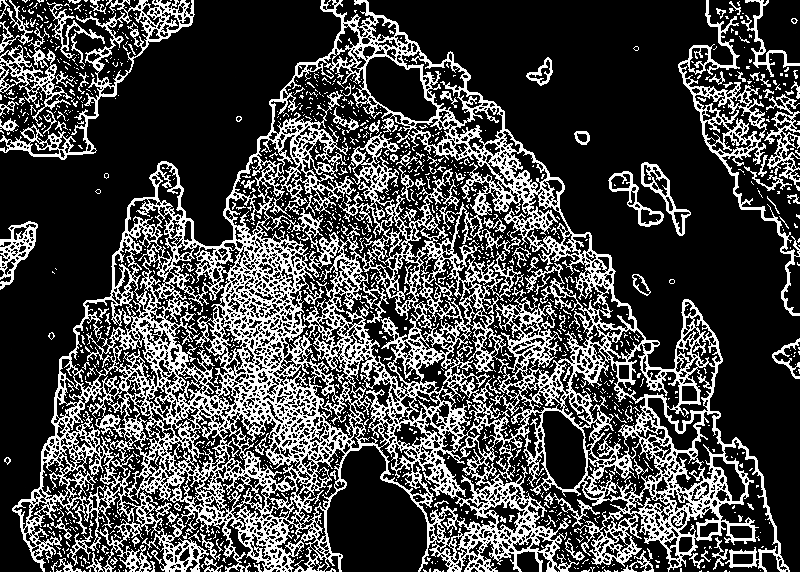

In [65]:
Image.fromarray(np.array(tf_rrr1[:, :, 1]*255, dtype=np.uint8))

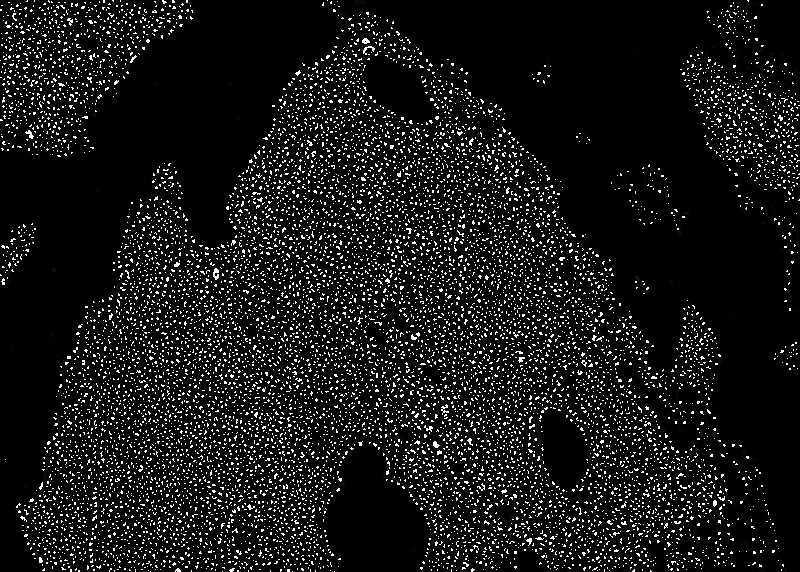

In [66]:
Image.fromarray(np.array(tf_ggg1[:, :, 0]*255, dtype=np.uint8))

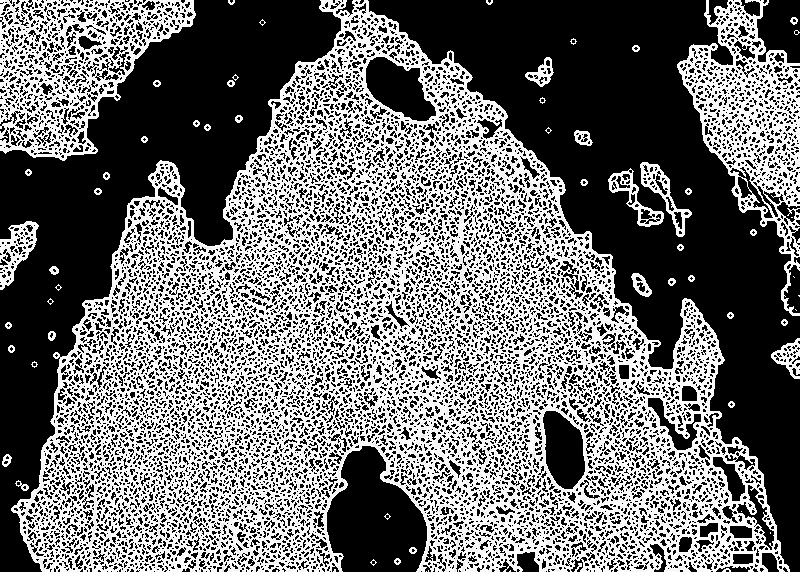

In [67]:
Image.fromarray(np.array(tf_ggg1[:, :, 1]*255, dtype=np.uint8))

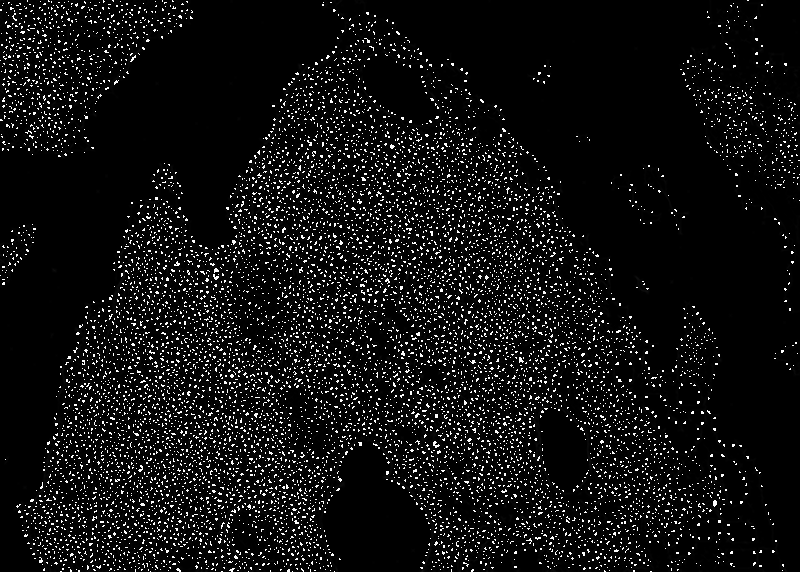

In [68]:
Image.fromarray(np.array(tf_bbb1[:, :, 0]*255, dtype=np.uint8))

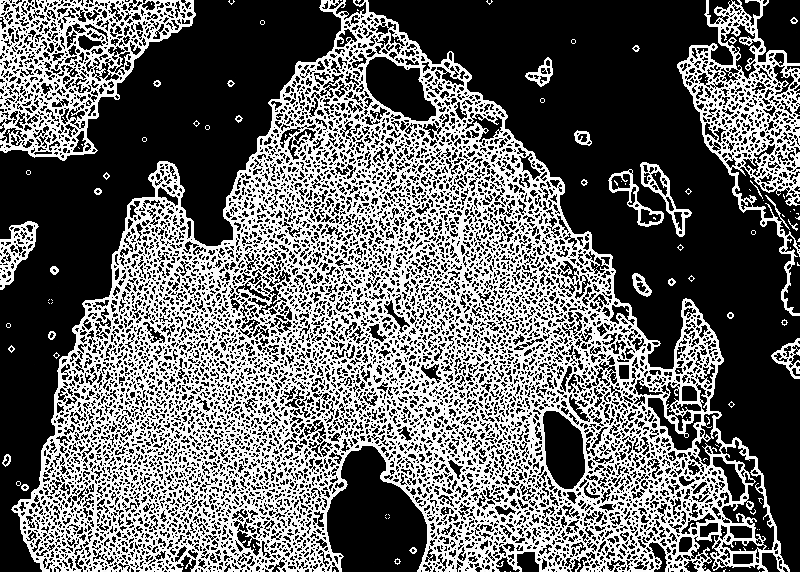

In [69]:
Image.fromarray(np.array(tf_bbb1[:, :, 1]*255, dtype=np.uint8))

In [70]:
tf_rrr2 = texture_feature(gf_rrr2)
tf_ggg2 = texture_feature(gf_ggg2)
tf_bbb2 = texture_feature(gf_bbb2)

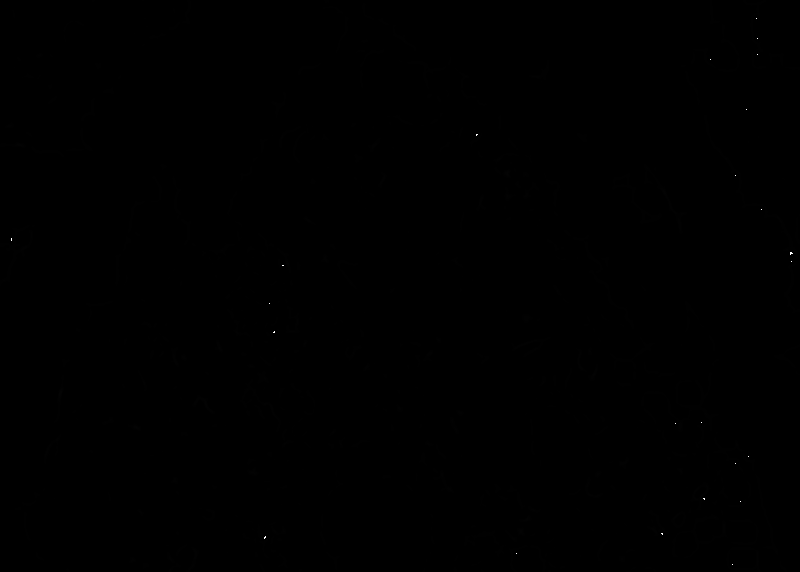

In [71]:
Image.fromarray(np.array(tf_rrr2[:, :, 0]*255, dtype=np.uint8))

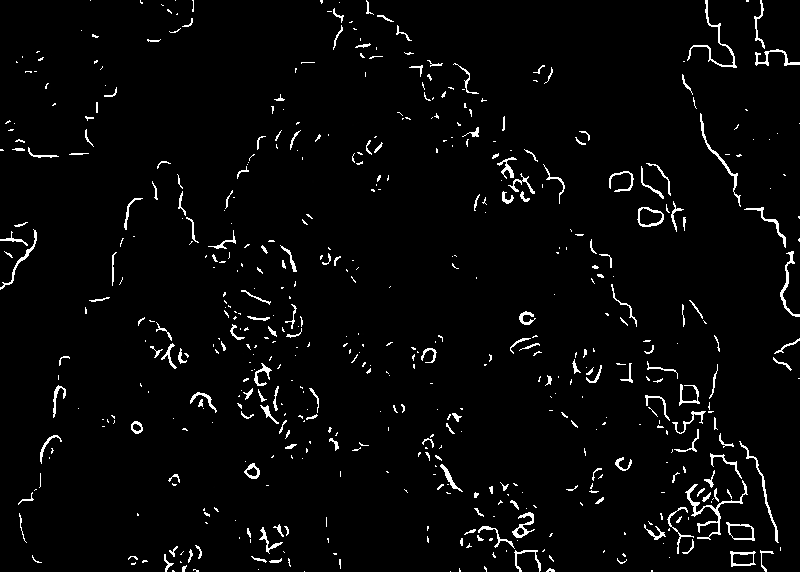

In [72]:
Image.fromarray(np.array(tf_rrr2[:, :, 1]*255, dtype=np.uint8))

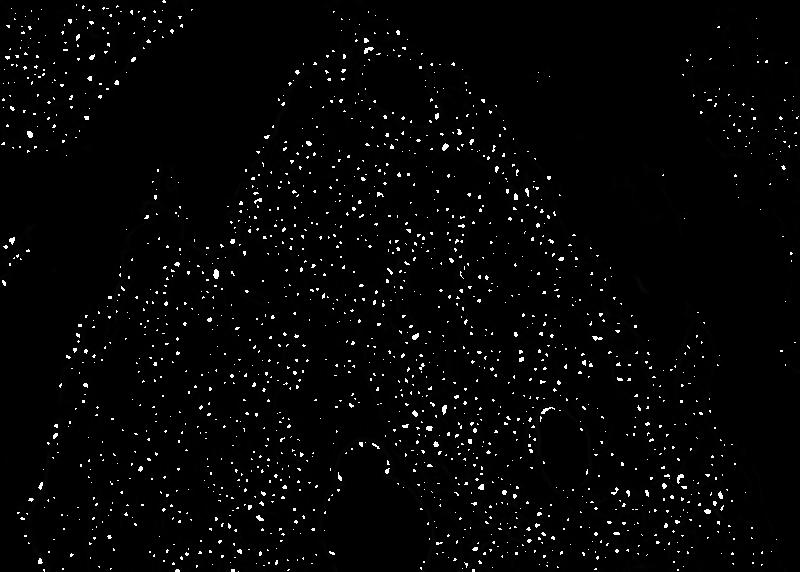

In [73]:
Image.fromarray(np.array(tf_ggg2[:, :, 0]*255, dtype=np.uint8))

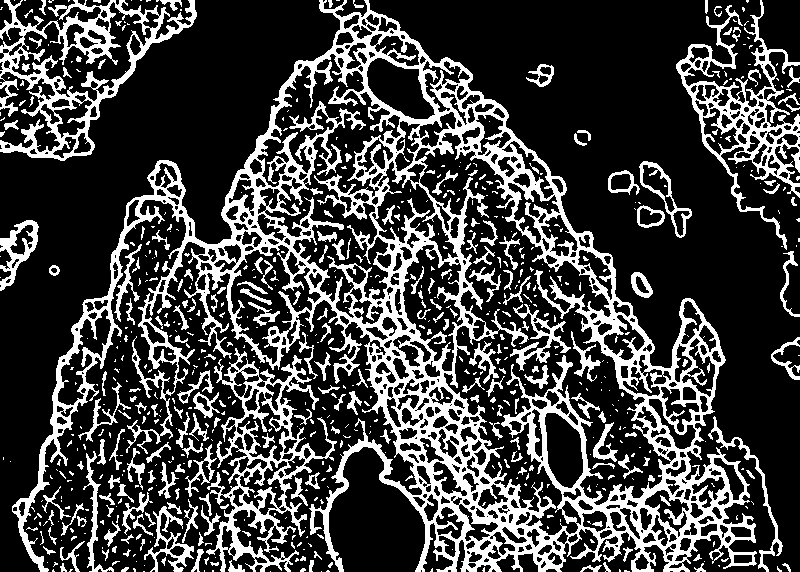

In [74]:
Image.fromarray(np.array(tf_ggg2[:, :, 1]*255, dtype=np.uint8))

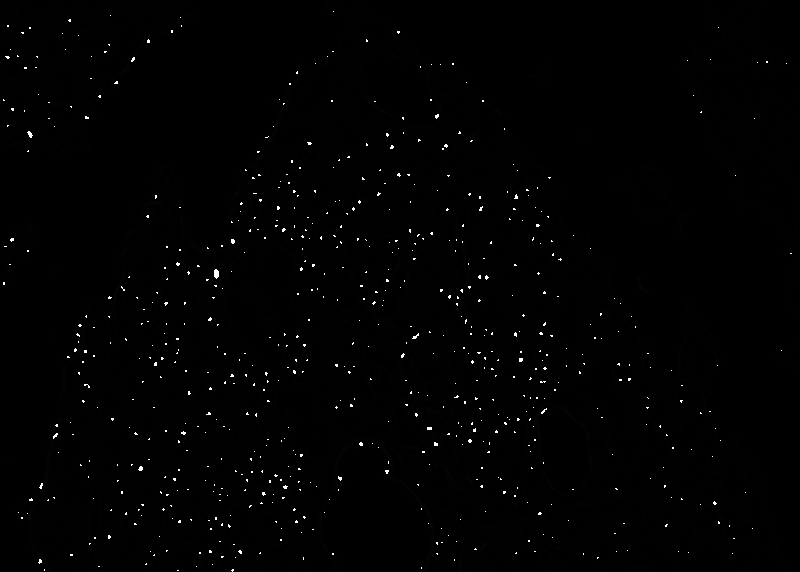

In [75]:
Image.fromarray(np.array(tf_bbb2[:, :, 0]*255, dtype=np.uint8))

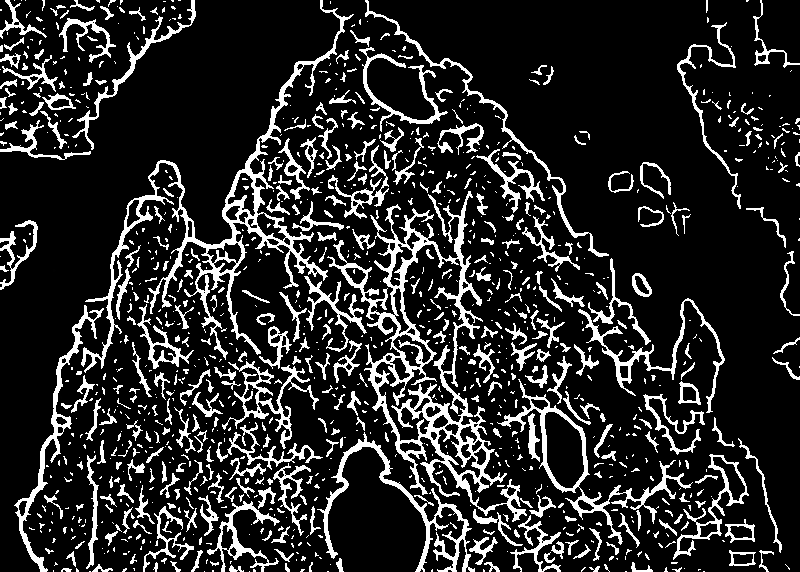

In [76]:
Image.fromarray(np.array(tf_bbb2[:, :, 1]*255, dtype=np.uint8))

In [77]:
tf_rrr3 = texture_feature(gf_rrr3)
tf_ggg3 = texture_feature(gf_ggg3)
tf_bbb3 = texture_feature(gf_bbb3)

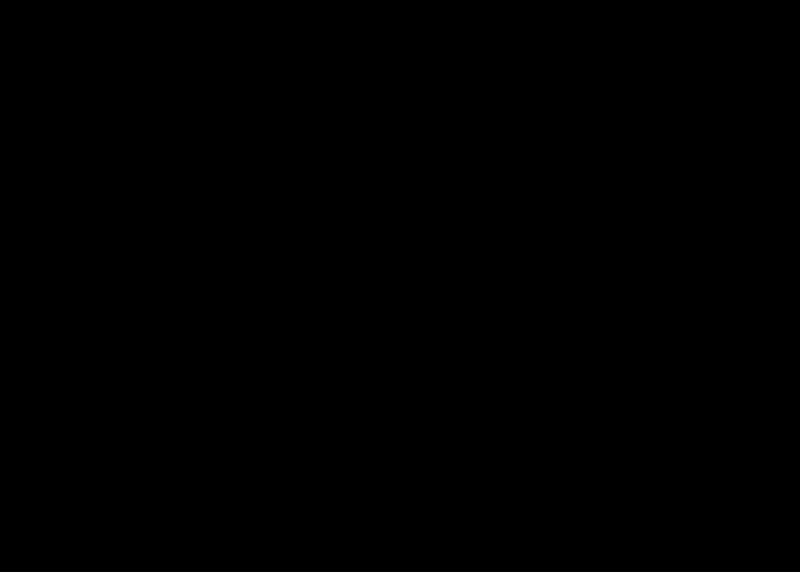

In [78]:
Image.fromarray(np.array(tf_rrr3[:, :, 0]*255, dtype=np.uint8))

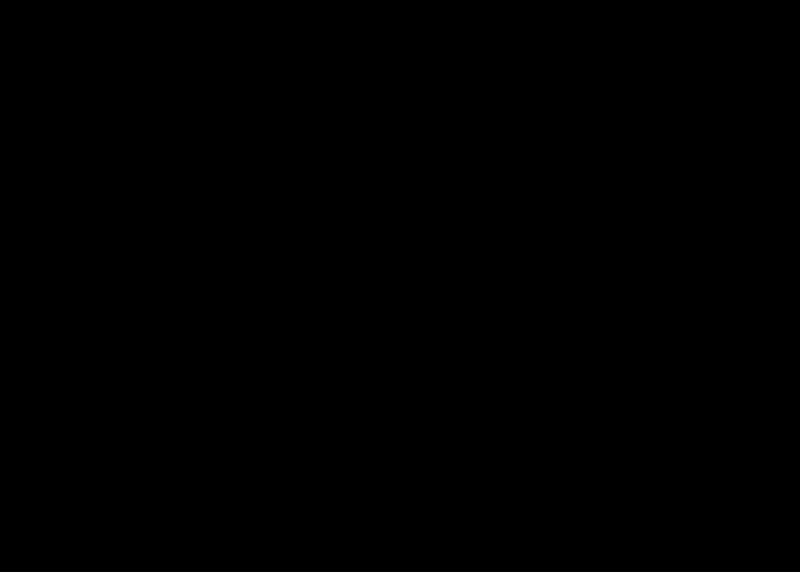

In [79]:
Image.fromarray(np.array(tf_rrr3[:, :, 1]*255, dtype=np.uint8))

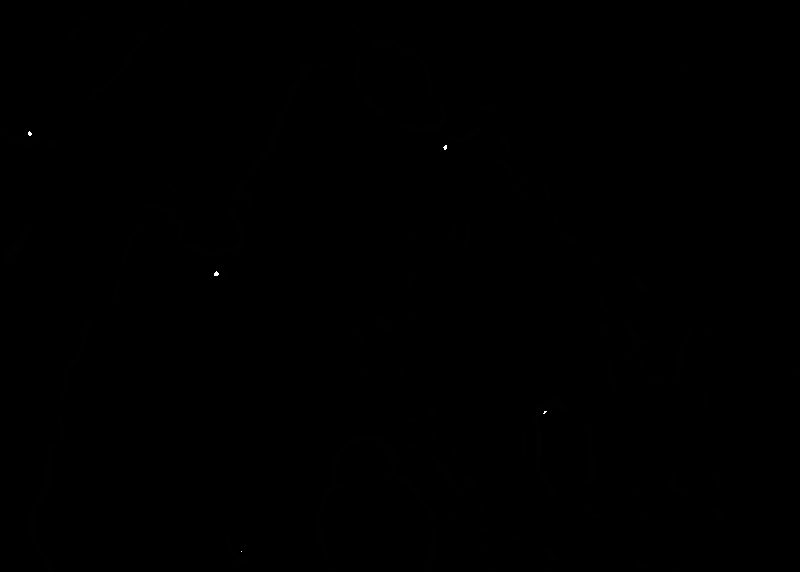

In [80]:
Image.fromarray(np.array(tf_ggg3[:, :, 0]*255, dtype=np.uint8))

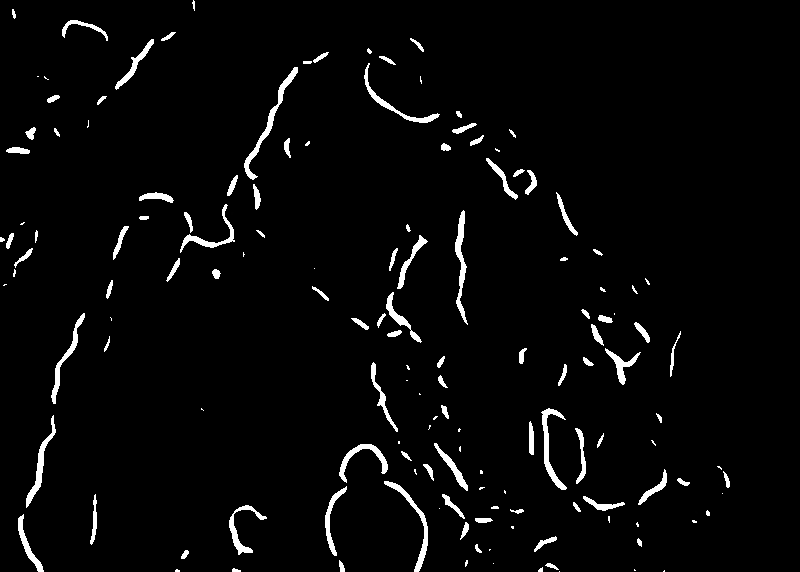

In [81]:
Image.fromarray(np.array(tf_ggg3[:, :, 1]*255, dtype=np.uint8))

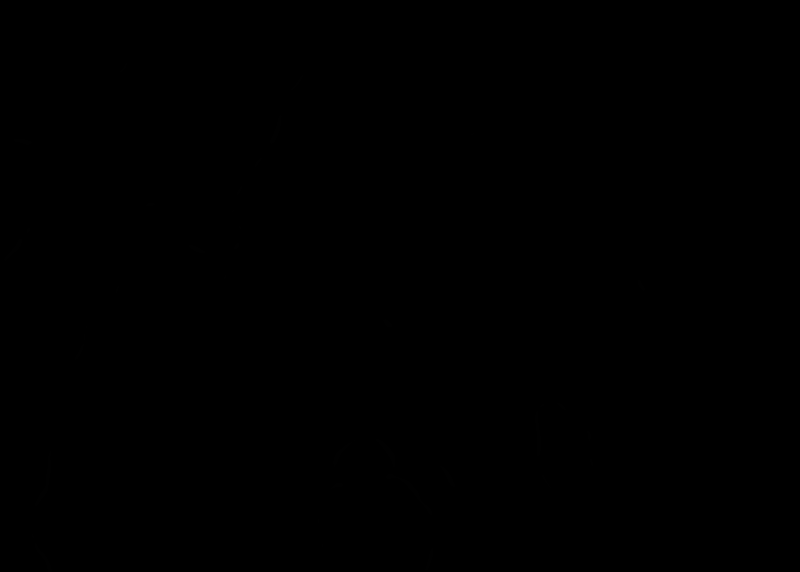

In [82]:
Image.fromarray(np.array(tf_bbb3[:, :, 0]*255, dtype=np.uint8))

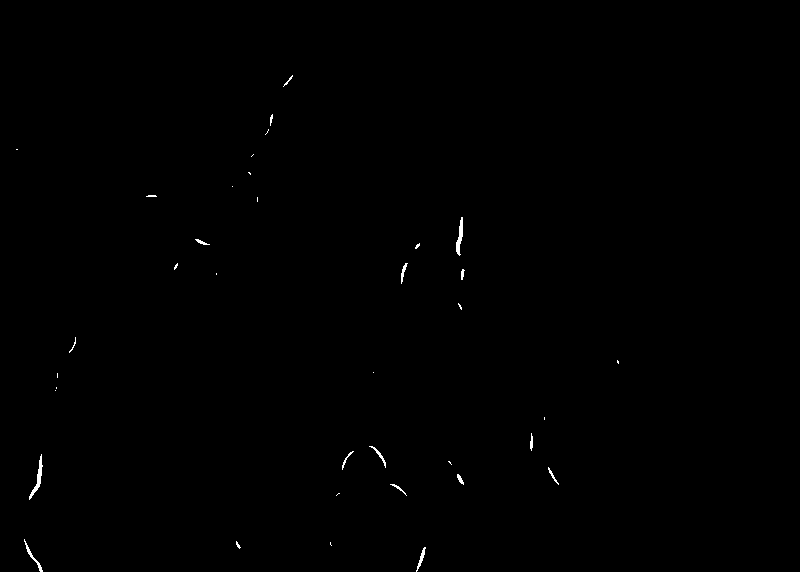

In [83]:
Image.fromarray(np.array(tf_bbb3[:, :, 1]*255, dtype=np.uint8))

In [84]:
tf_rrr4 = texture_feature(gf_rrr4)
tf_ggg4 = texture_feature(gf_ggg4)
tf_bbb4 = texture_feature(gf_bbb4)

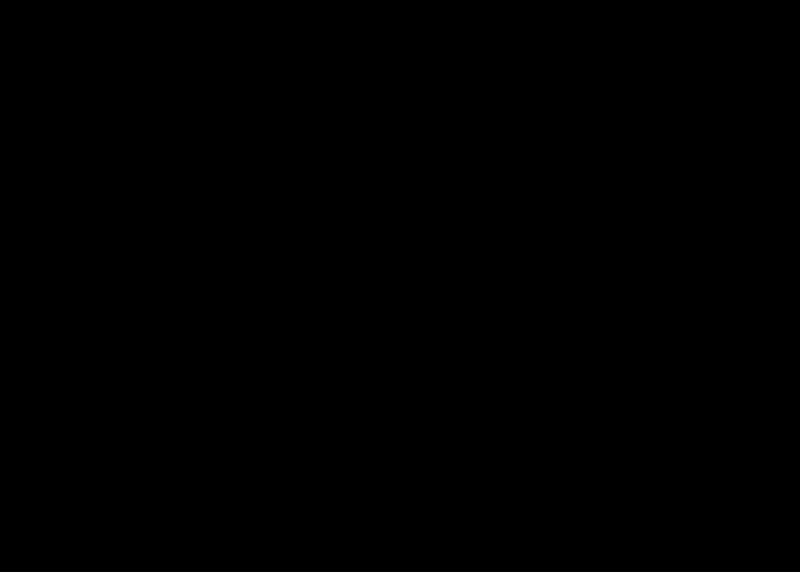

In [85]:
Image.fromarray(np.array(tf_rrr4[:, :, 0]*255, dtype=np.uint8))

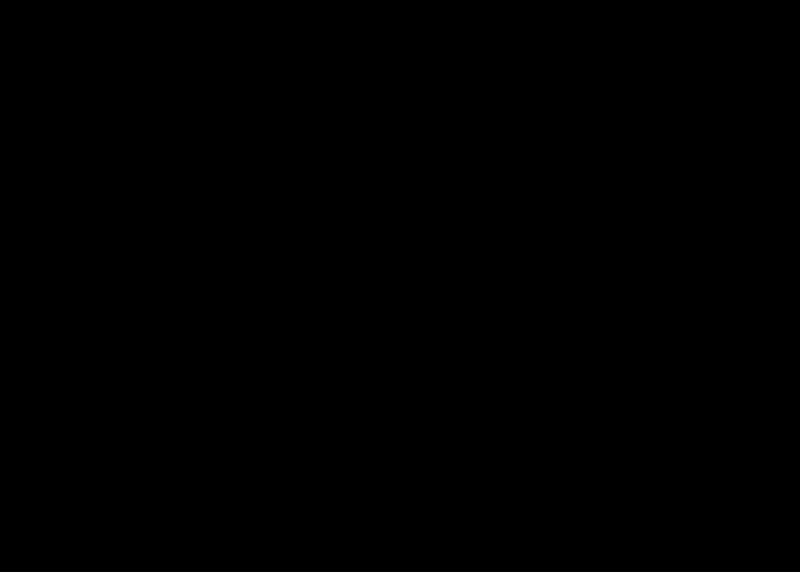

In [86]:
Image.fromarray(np.array(tf_rrr4[:, :, 1]*255, dtype=np.uint8))

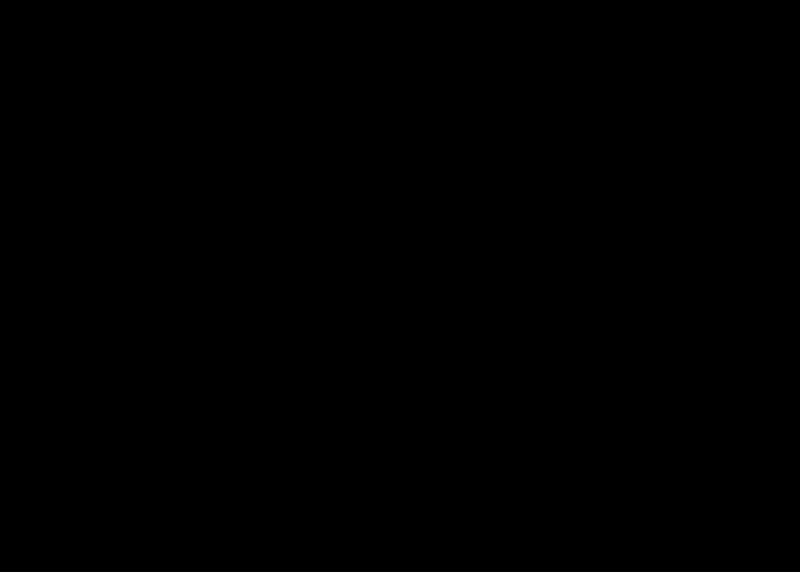

In [87]:
Image.fromarray(np.array(tf_ggg4[:, :, 0]*255, dtype=np.uint8))

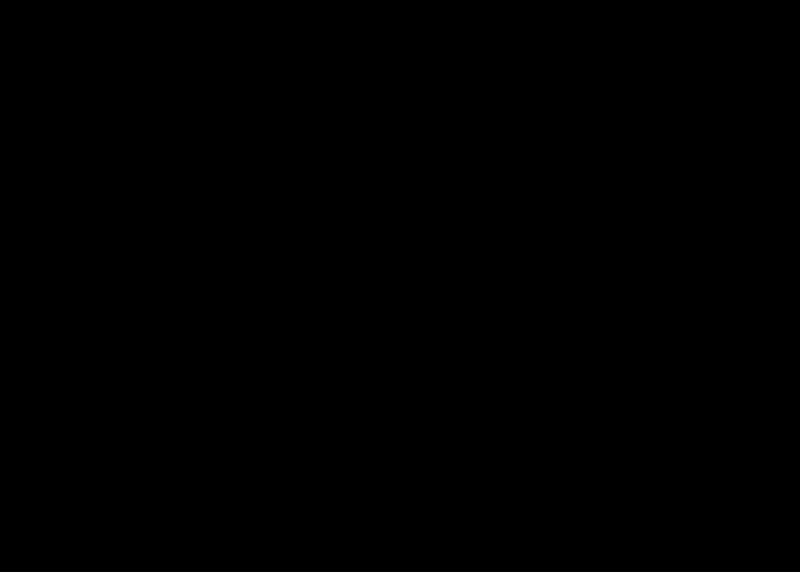

In [88]:
Image.fromarray(np.array(tf_ggg4[:, :, 1]*255, dtype=np.uint8))

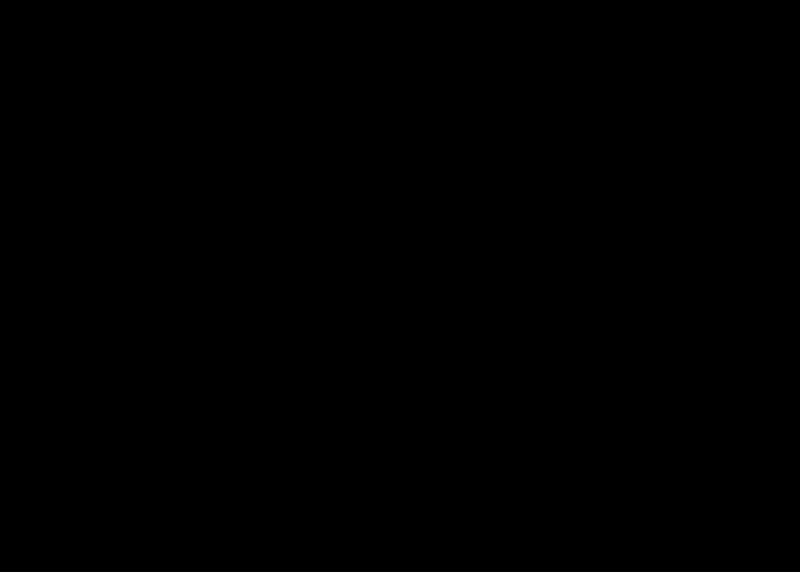

In [89]:
Image.fromarray(np.array(tf_bbb4[:, :, 0]*255, dtype=np.uint8))

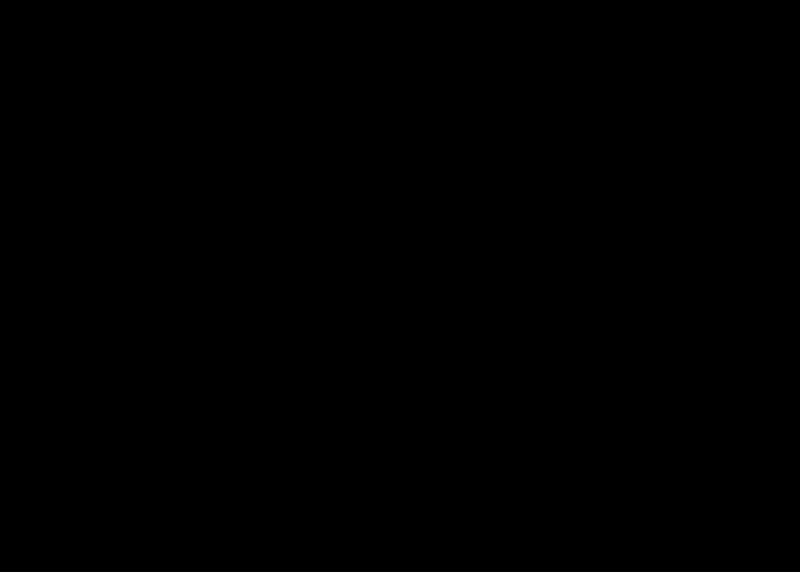

In [90]:
Image.fromarray(np.array(tf_bbb4[:, :, 1]*255, dtype=np.uint8))

In [91]:
tf_rrr5 = texture_feature(gf_rrr5)
tf_ggg5 = texture_feature(gf_ggg5)
tf_bbb5 = texture_feature(gf_bbb5)

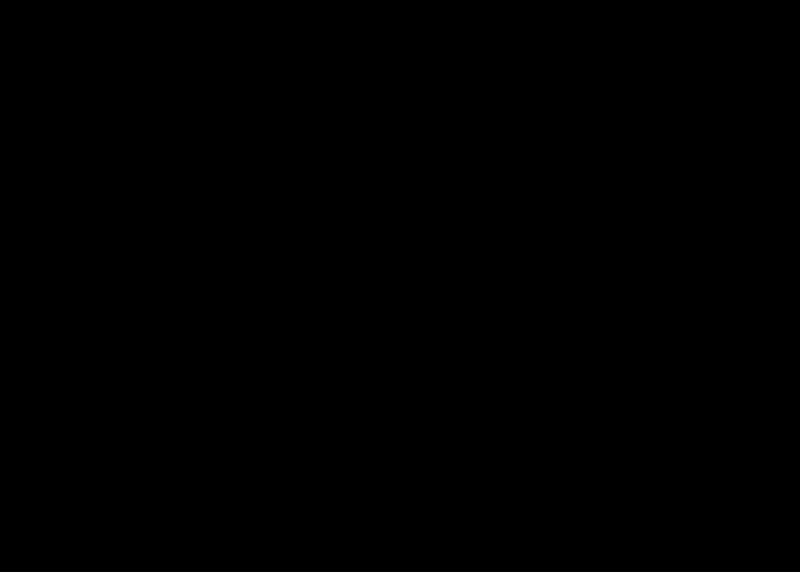

In [92]:
Image.fromarray(np.array(tf_rrr5[:, :, 0]*255, dtype=np.uint8))

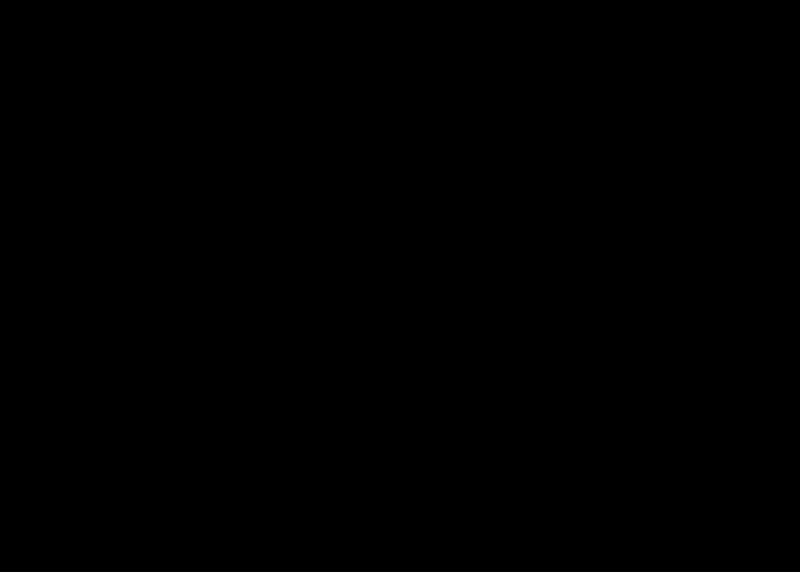

In [93]:
Image.fromarray(np.array(tf_rrr5[:, :, 1]*255, dtype=np.uint8))

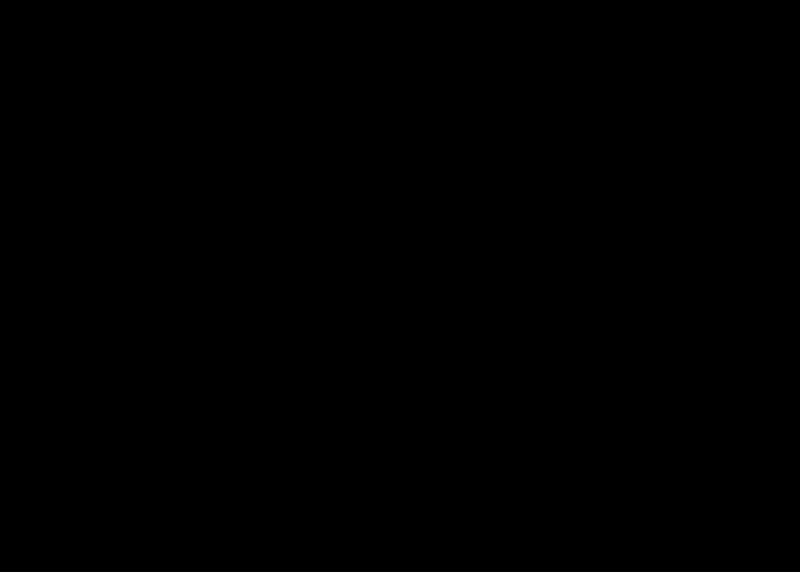

In [94]:
Image.fromarray(np.array(tf_ggg5[:, :, 0]*255, dtype=np.uint8))

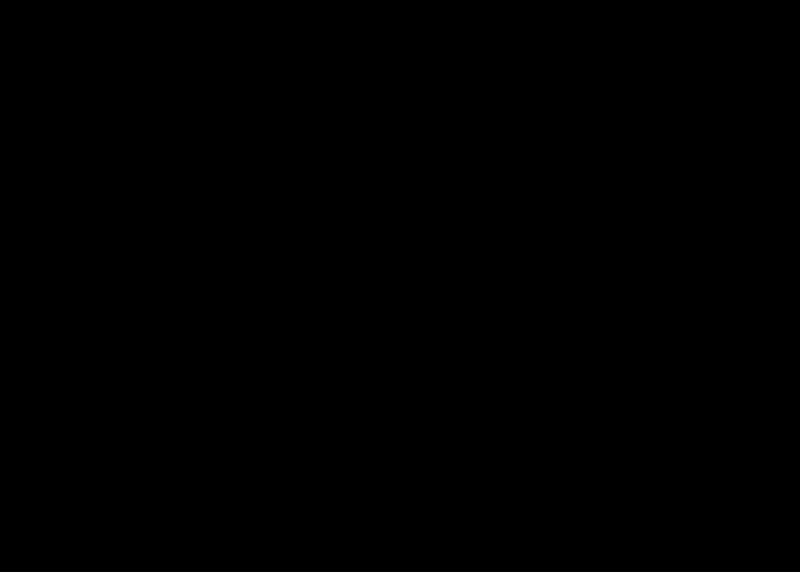

In [95]:
Image.fromarray(np.array(tf_ggg5[:, :, 1]*255, dtype=np.uint8))

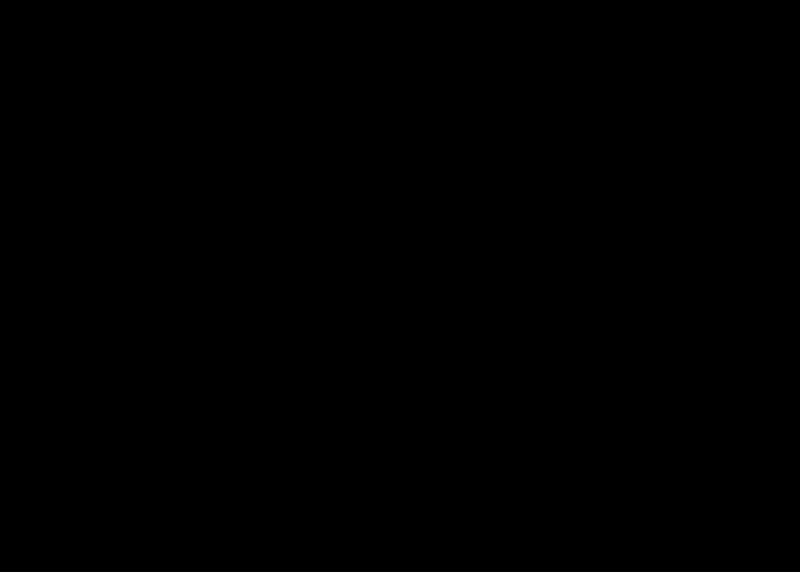

In [96]:
Image.fromarray(np.array(tf_bbb5[:, :, 0]*255, dtype=np.uint8))

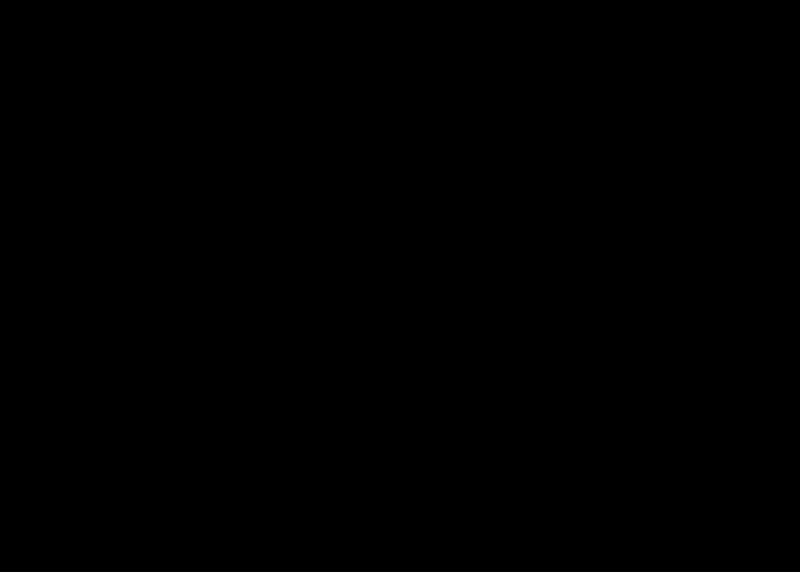

In [97]:
Image.fromarray(np.array(tf_bbb5[:, :, 1]*255, dtype=np.uint8))

In [102]:
result = feature.texture.greycomatrix(ggg, [1], [0], levels=256)
result.shape

(256, 256, 1, 1)

In [105]:
#https://stackoverflow.com/questions/42459493/sliding-window-in-python-for-glcm-calculation

import numpy as np
from skimage import io
from scipy import stats
from skimage.feature import greycoprops

def offset(length, angle):
    """Return the offset in pixels for a given length and angle"""
    dv = length * np.sign(-np.sin(angle)).astype(np.int32)
    dh = length * np.sign(np.cos(angle)).astype(np.int32)
    return dv, dh

def crop(img, center, win):
    """Return a square crop of img centered at center (side = 2*win + 1)"""
    row, col = center
    side = 2*win + 1
    first_row = row - win
    first_col = col - win
    last_row = first_row + side    
    last_col = first_col + side
    return img[first_row: last_row, first_col: last_col]

def cooc_maps(img, center, win, d=[1], theta=[0], levels=256):
    """
    Return a set of co-occurrence maps for different d and theta in a square 
    crop centered at center (side = 2*w + 1)
    """
    shape = (2*win + 1, 2*win + 1, len(d), len(theta))
    cooc = np.zeros(shape=shape, dtype=np.int32)
    row, col = center
    Ii = crop(img, (row, col), win)
    for d_index, length in enumerate(d):
        for a_index, angle in enumerate(theta):
            dv, dh = offset(length, angle)
            Ij = crop(img, center=(row + dv, col + dh), win=win)
            cooc[:, :, d_index, a_index] = encode_cooccurrence(Ii, Ij, levels)
    return cooc

def encode_cooccurrence(x, y, levels=256):
    """Return the code corresponding to co-occurrence of intensities x and y"""
    return x*levels + y

def decode_cooccurrence(code, levels=256):
    """Return the intensities x, y corresponding to code"""
    return code//levels, np.mod(code, levels)    

def compute_glcms(cooccurrence_maps, levels=256):
    """Compute the cooccurrence frequencies of the cooccurrence maps"""
    Nr, Na = cooccurrence_maps.shape[2:]
    glcms = np.zeros(shape=(levels, levels, Nr, Na), dtype=np.float64)
    for r in range(Nr):
        for a in range(Na):
            table = stats.itemfreq(cooccurrence_maps[:, :, r, a])
            codes = table[:, 0]
            freqs = table[:, 1]/float(table[:, 1].sum())
            i, j = decode_cooccurrence(codes, levels=levels)
            glcms[i, j, r, a] = freqs
    return glcms

def compute_props(glcms, props=('contrast',)):
    """Return a feature vector corresponding to a set of GLCM"""
    Nr, Na = glcms.shape[2:]
    features = np.zeros(shape=(Nr, Na, len(props)))
    for index, prop_name in enumerate(props):
        features[:, :, index] = greycoprops(glcms, prop_name)
    return features.ravel()

def haralick_features(img, win, d, theta, levels, props):
    """Return a map of Haralick features (one feature vector per pixel)"""
    rows, cols = img.shape
    margin = win + max(d)
    arr = np.pad(img, margin, mode='reflect')
    n_features = len(d) * len(theta) * len(props)
    feature_map = np.zeros(shape=(rows, cols, n_features), dtype=np.float64)
    for m in range(rows):
        for n in range(cols):
            coocs = cooc_maps(arr, (m + margin, n + margin), win, d, theta, levels)
            glcms = compute_glcms(coocs, levels)
            feature_map[m, n, :] = compute_props(glcms, props)
    return feature_map

In [110]:
tst = haralick_features(ggg, 4, [1], [0], 256, ('contrast', 'dissimilarity', 'homogeneity', 'energy', 'correlation', 'ASM'))

/home/ubuntu/anaconda3/envs/repath/lib/python3.6/site-packages/ipykernel_launcher.py:54: DeprecationWarning: `itemfreq` is deprecated!
`itemfreq` is deprecated and will be removed in a future version. Use instead `np.unique(..., return_counts=True)`


In [111]:
tst.shape

(572, 800, 6)

In [118]:
from skimage import exposure

cont = exposure.rescale_intensity(tst[:, :, 0], out_range=np.uint8)
diss = exposure.rescale_intensity(tst[:, :, 1], out_range=np.uint8)
homg = exposure.rescale_intensity(tst[:, :, 2], out_range=np.uint8)
ener = exposure.rescale_intensity(tst[:, :, 3], out_range=np.uint8)
corr = exposure.rescale_intensity(tst[:, :, 4], out_range=np.uint8)
asm = exposure.rescale_intensity(tst[:, :, 5], out_range=np.uint8)

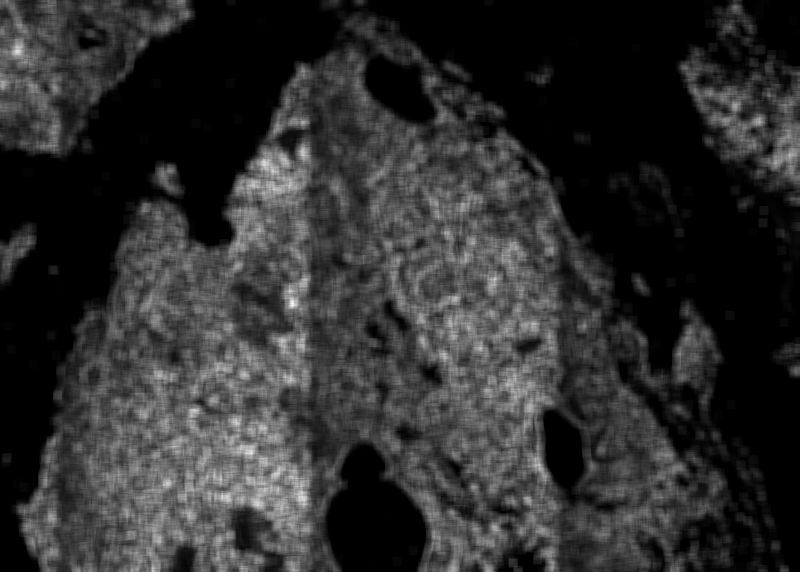

In [117]:
Image.fromarray(cont)

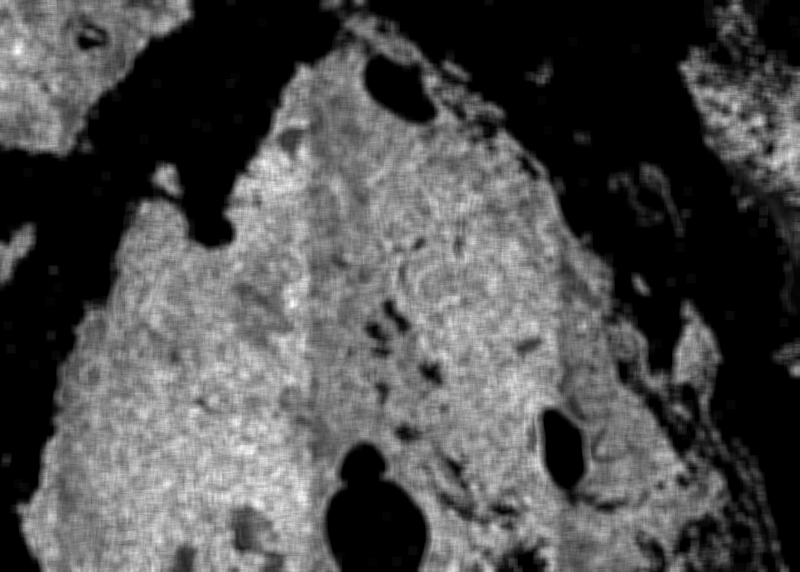

In [119]:
Image.fromarray(diss)

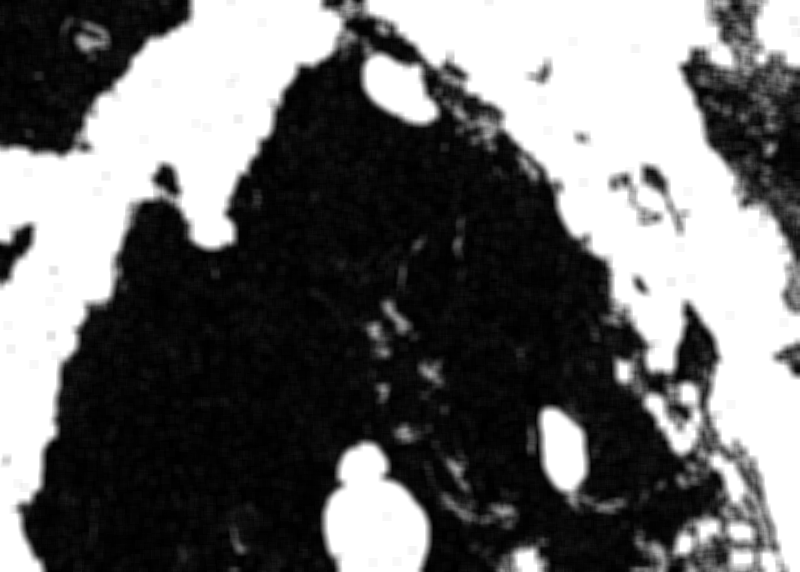

In [120]:
Image.fromarray(homg)

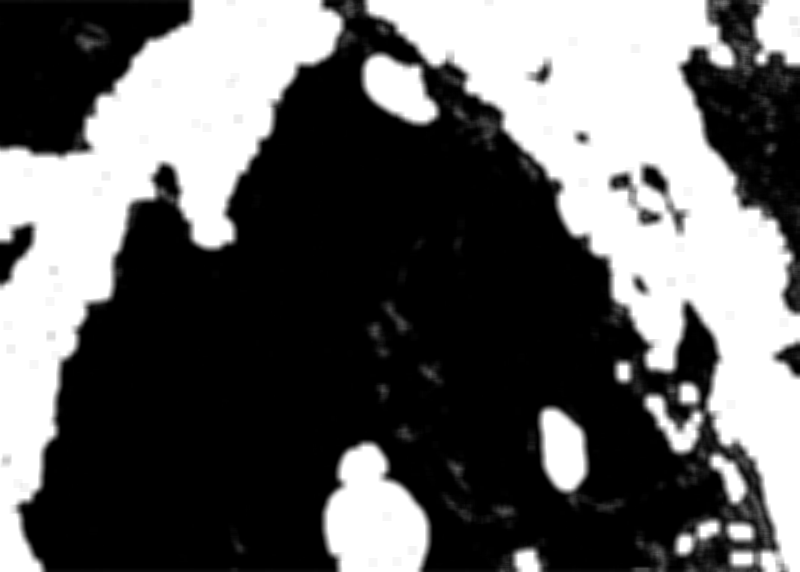

In [121]:
Image.fromarray(ener)

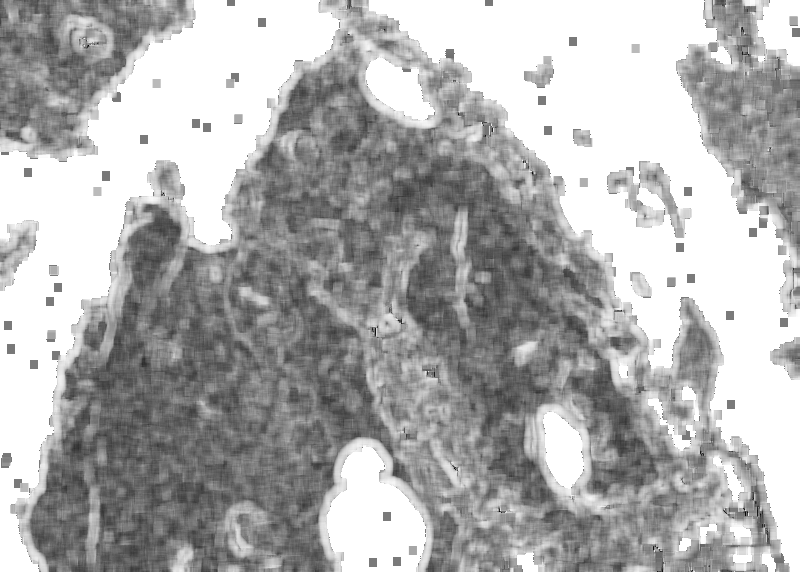

In [122]:
Image.fromarray(corr)

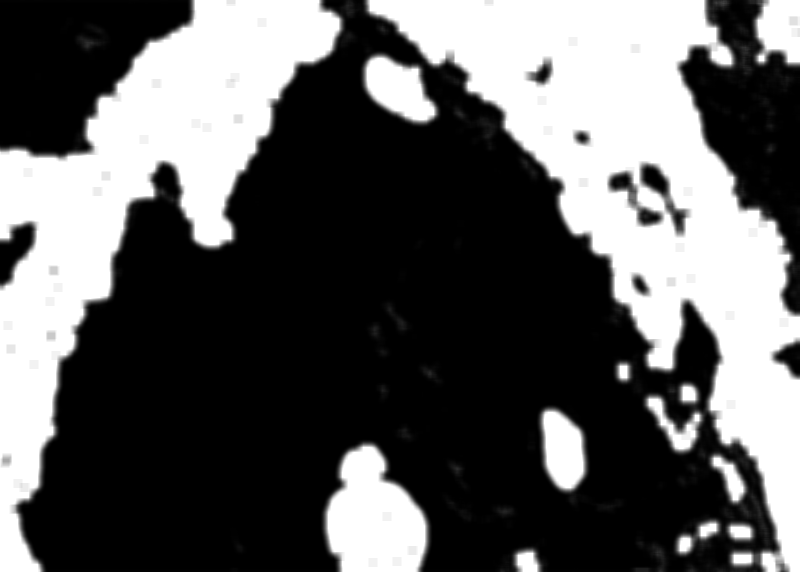

In [123]:
Image.fromarray(asm)